<a href="https://colab.research.google.com/github/aarmintia/FTW-Capstone_Guide-to-Stock-Market/blob/main/Stock_Price_Analysis_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Importing Libraries

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
import math
from scipy import stats
import matplotlib.dates as mdates
from plotly import tools
import plotly.tools as tls
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, plot, iplot

init_notebook_mode(connected=True)
%matplotlib inline
# matplotlib defaults
plt.style.use("fivethirtyeight")
plt.rc("figure", autolayout=True)
plt.rc(
    "axes",
    labelweight="bold",
    labelsize="large",
    titleweight="bold",
    titlesize=14,
    titlepad=10,
)
import warnings
warnings.filterwarnings("ignore")

## Data analysis and visualizations

In [ ]:
# read the dataframe
dfi = pd.read_csv("merged_file_with_name.csv")

dfi.columns = dfi.columns.str.replace(' ', '')

In [ ]:
dfi['Date'] = pd.to_datetime(dfi['Date'])

df = dfi.groupby('Name', group_keys=False).apply(lambda x: x.sort_values('Date')).reset_index(drop=True)

df['Volume'] = pd.to_numeric(df['Volume'], errors='coerce').astype(int)

df.head().style.set_properties(**{'background-color': 'black',
                                          'color': 'lawngreen',
                                          'border': '1.5px  white'})


,Date,Open,High,Low,Close,Volume,Name
0,2018-11-15 00:00:00,866.965000,875.199000,863.575000,869.871000,196270,AC
1,2018-11-16 00:00:00,869.871000,886.339000,869.871000,876.652000,405360,AC
2,2018-11-19 00:00:00,889.245000,915.884000,886.339000,915.884000,248330,AC
3,2018-11-20 00:00:00,907.650000,915.399000,897.963000,905.713000,172200,AC
4,2018-11-21 00:00:00,902.806000,902.806000,887.792000,892.151000,231910,AC


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35510 entries, 0 to 35509
Data columns (total 7 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   Date    35510 non-null  datetime64[ns]
 1   Open    35510 non-null  float64       
 2   High    35510 non-null  float64       
 3   Low     35510 non-null  float64       
 4   Close   35510 non-null  float64       
 5   Volume  35510 non-null  int64         
 6   Name    35510 non-null  object        
dtypes: datetime64[ns](1), float64(4), int64(1), object(1)
memory usage: 1.9+ MB


In [ ]:
# define simple function get all the information needed
def information_func(df):

    # unique stocks
    print("Uniques stocks available in dataset:", df['Name'].nunique())
    print("----"*20)

    # metadata of dataset
    print("Metadata of the dataset:\n")
    df.info()
    print("----"*20)

    # missing values
    null = df.isnull().sum()
    print(null)
    print("----"*20)

    # max range of stocks dataset
    delta = (pd.to_datetime(df['Date']).max() - pd.to_datetime(df['Date']).min())
    print("Time range of stocks dataset:\n", delta)
    print("----"*20)

In [ ]:
information_func(df)

Uniques stocks available in dataset: 30
--------------------------------------------------------------------------------
Metadata of the dataset:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35510 entries, 0 to 35509
Data columns (total 7 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   Date    35510 non-null  datetime64[ns]
 1   Open    35510 non-null  float64       
 2   High    35510 non-null  float64       
 3   Low     35510 non-null  float64       
 4   Close   35510 non-null  float64       
 5   Volume  35510 non-null  int64         
 6   Name    35510 non-null  object        
dtypes: datetime64[ns](1), float64(4), int64(1), object(1)
memory usage: 1.9+ MB
--------------------------------------------------------------------------------
Date      0
Open      0
High      0
Low       0
Close     0
Volume    0
Name      0
dtype: int64
--------------------------------------------------------------------------------
Time rang

## Data cleaning

In [ ]:
# rename Name to ticks
rdf = df.rename(columns={'Name':'ticks'})

# drop the null as they a few values and time-series won't be affected by such values
rdf.dropna(inplace=True)

# change the dtype of date column
new_df = rdf.copy()
new_df.loc[:, 'Date'] = pd.to_datetime(rdf.loc[:, 'Date'], format='%Y/%m/%d')

# new dataframe info
new_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35510 entries, 0 to 35509
Data columns (total 7 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   Date    35510 non-null  datetime64[ns]
 1   Open    35510 non-null  float64       
 2   High    35510 non-null  float64       
 3   Low     35510 non-null  float64       
 4   Close   35510 non-null  float64       
 5   Volume  35510 non-null  int64         
 6   ticks   35510 non-null  object        
dtypes: datetime64[ns](1), float64(4), int64(1), object(1)
memory usage: 1.9+ MB


## Top 30 stock tickers by average trade volume

In [ ]:
# find the average volume of each stocks using function and sort top 10 most traded stocks for further analysis
mean_dict = {}

# find average of volume traded over a period of time using for loops
for key in new_df['ticks'].unique():
    value = new_df[new_df['ticks'] == key ]['Volume'].mean()
    mean_dict[key]= value

print("Length of the mean of ticks dictionary:", len(mean_dict))

# convert dict to pandas dataframe
avaerage_s = pd.Series(mean_dict).transpose()
top30_s = avaerage_s.sort_values(ascending=False)[:]

print("Top 30 company tickers with highest average traded stock volume:\n", top30_s.index)

Length of the mean of ticks dictionary: 30
Top 30 company tickers with highest average traded stock volume:
 Index(['ACEN', 'MONDE', 'ALI', 'CNVRG', 'SMPH', 'DMC', 'NIKL', 'AGI', 'BLOOM',
       'EMI', 'LTG', 'BDO', 'MBT', 'SCC', 'BPI', 'WLCON', 'PGOLD', 'JGS',
       'ICT', 'CNPF', 'AEV', 'URC', 'JFC', 'SM', 'AC', 'SMC', 'MER', 'GTCAP',
       'TEL', 'GLO'],
      dtype='object')


In [ ]:
# function to return top 10 sub dataframe
def subdataframe(df, tick):

    # top 10 ticks
    ticks = list(top30_s.index)

    assert tick in ticks, """Stock tick does not belong to top 10 stocks by trade volume, please try any of these:\n
    ['ACEN', 'MONDE', 'ALI', 'CNVRG', 'SMPH', 'DMC', 'NIKL', 'AGI', 'BLOOM',
       'EMI', 'LTG', 'BDO', 'MBT', 'SCC', 'BPI', 'WLCON', 'PGOLD', 'JGS',
       'ICT', 'CNPF', 'AEV', 'URC', 'JFC', 'SM', 'AC', 'SMC', 'MER', 'GTCAP',
       'TEL', 'GLO']"""

    ndf = new_df[new_df['ticks'] == tick]
    return ndf

In [ ]:
# company dict for respective ticks (TOP 10 STOCKS BY AVERAGE TRAE VOLUME)
company_dict = {'ACEN' : 'ACEN CORPORATION',
                'MONDE' : 'Monde Nissin Corporation',
                'ALI' : 'Ayala Land, Inc.',
                'CNVRG' : 'Converge Information and Communications Technology Solutions, Inc.',
                'SMPH' : 'SM Prime Holdings, Inc.',
                'DMC' : 'DMCI Holdings, Inc.',
                'NIKL' : 'Nickel Asia Corporation',
                'AGI' : 'Alliance Global Group, Inc.',
                'BLOOM' : 'Bloomberry Resorts Corporation',
                'EMI' : 'Emperador Inc.',
                'LTG' : 'LT Group, Inc.',
                'BDO' : 'BDO Unibank, Inc.',
                'MBT' : 'Metropolitan Bank & Trust Company',
                'SCC' : 'Semirara Mining and Power Corporation',
                'BPI' : 'Bank of the Philippine Islands',
                'WLCON' : 'Wilcon Depot, Inc.',
                'PGOLD' : 'Puregold Price Club, Inc.',
                'JGS' : 'JG Summit Holdings, Inc.',
                'ICT' : 'International Container Terminal Services, Inc.',
                'CNPF' : 'Century Pacific Food, Inc.',
                'AEV' : 'Aboitiz Equity Ventures, Inc.',
                'URC' : 'Universal Robina Corporation',
                'JFC' : 'Jollibee Foods Corporation',
                'SM' : 'SM Investments Corporation',
                'AC' : 'Ayala Corporation',
                'SMC' : 'San Miguel Corporation',
                'MER' : 'Manila Electric Company',
                'GTCAP' : 'GT Capital Holdings, Inc.',
                'TEL' : 'PLDT Inc.',
                'GLO' : 'Globe Telecom, Inc.'
               }

acen_df = subdataframe(new_df, 'ACEN')
monde_df = subdataframe(new_df, 'MONDE')
ali_df = subdataframe(new_df, 'ALI')
cnvrg_df = subdataframe(new_df, 'CNVRG')
smph_df = subdataframe(new_df, 'SMPH')
dmc_df = subdataframe(new_df, 'DMC')
nikl_df = subdataframe(new_df, 'NIKL')
agi_df = subdataframe(new_df, 'AGI')
bloom_df = subdataframe(new_df, 'BLOOM')
emi_df = subdataframe(new_df, 'EMI')
ltg_df = subdataframe(new_df, 'LTG')
bdo_df = subdataframe(new_df, 'BDO')
mbt_df = subdataframe(new_df, 'MBT')
scc_df = subdataframe(new_df, 'SCC')
bpi_df = subdataframe(new_df, 'BPI')
wlcon_df = subdataframe(new_df, 'WLCON')
pgold_df = subdataframe(new_df, 'PGOLD')
jgs_df = subdataframe(new_df, 'JGS')
ict_df = subdataframe(new_df, 'ICT')
cnpf_df = subdataframe(new_df, 'CNPF')
aev_df = subdataframe(new_df, 'AEV')
urc_df = subdataframe(new_df, 'URC')
jfc_df = subdataframe(new_df, 'JFC')
sm_df = subdataframe(new_df, 'SM')
ac_df = subdataframe(new_df, 'AC')
smc_df = subdataframe(new_df, 'SMC')
mer_df = subdataframe(new_df, 'MER')
gtcap_df = subdataframe(new_df, 'GTCAP')
tel_df = subdataframe(new_df, 'TEL')
glo_df = subdataframe(new_df, 'GLO')

# define a function to return daily return and company column
def dailyfunc(df):
    df['daily return'] = ((df['Close'] - df['Open'])/df['Open'])*100
    df.style.format('{:.2f}%', subset='daily return')
    df['daily_mean'] = (df['Open'] + df['Close'] + df['High'] + df['Low'])/4
    df['co_name'] = company_dict[df['ticks'].unique()[0]]
    return df

acen_df = dailyfunc(acen_df)
monde_df = dailyfunc(monde_df)
ali_df = dailyfunc(ali_df)
cnvrg_df = dailyfunc(cnvrg_df)
smph_df = dailyfunc(smph_df)
dmc_df = dailyfunc(dmc_df)
nikl_df = dailyfunc(nikl_df)
agi_df = dailyfunc(agi_df)
bloom_df = dailyfunc(bloom_df)
emi_df = dailyfunc(emi_df)
ltg_df = dailyfunc(ltg_df)
bdo_df = dailyfunc(bdo_df)
mbt_df = dailyfunc(mbt_df)
scc_df = dailyfunc(scc_df)
bpi_df = dailyfunc(bpi_df)
wlcon_df = dailyfunc(wlcon_df)
pgold_df = dailyfunc(pgold_df)
jgs_df = dailyfunc(jgs_df)
ict_df = dailyfunc(ict_df)
cnpf_df = dailyfunc(cnpf_df)
aev_df = dailyfunc(aev_df)
urc_df = dailyfunc(urc_df)
jfc_df = dailyfunc(jfc_df)
sm_df = dailyfunc(sm_df)
ac_df = dailyfunc(ac_df)
smc_df = dailyfunc(smc_df)
mer_df = dailyfunc(mer_df)
gtcap_df = dailyfunc(gtcap_df)
tel_df = dailyfunc(tel_df)
glo_df = dailyfunc(glo_df)

print('\t\tStart Date\t\t\t\t\tEnd Date')
print(f"ACEN\t\t{acen_df['Date'].min()}\t\t\t{acen_df['Date'].max()}")
print(f"MONDE\t\t{monde_df['Date'].min()}\t\t\t{monde_df['Date'].max()}")
print(f"ALI\t\t{ali_df['Date'].min()}\t\t\t{ali_df['Date'].max()}")
print(f"CNVRG\t\t{cnvrg_df['Date'].min()}\t\t\t{cnvrg_df['Date'].max()}")
print(f"SMPH\t\t{smph_df['Date'].min()}\t\t\t{smph_df['Date'].max()}")
print(f"DMC\t\t{dmc_df['Date'].min()}\t\t\t{dmc_df['Date'].max()}")
print(f"NIKL\t\t{nikl_df['Date'].min()}\t\t\t{nikl_df['Date'].max()}")
print(f"AGI\t\t{agi_df['Date'].min()}\t\t\t{agi_df['Date'].max()}")
print(f"BLOOM\t\t{bloom_df['Date'].min()}\t\t\t{bloom_df['Date'].max()}")
print(f"EMI\t\t{emi_df['Date'].min()}\t\t\t{emi_df['Date'].max()}")
print(f"LTG\t\t{ltg_df['Date'].min()}\t\t\t{ltg_df['Date'].max()}")
print(f"BDO\t\t{bdo_df['Date'].min()}\t\t\t{bdo_df['Date'].max()}")
print(f"MBT\t\t{mbt_df['Date'].min()}\t\t\t{mbt_df['Date'].max()}")
print(f"SCC\t\t{scc_df['Date'].min()}\t\t\t{scc_df['Date'].max()}")
print(f"BPI\t\t{bpi_df['Date'].min()}\t\t\t{bpi_df['Date'].max()}")
print(f"WLCON\t\t{wlcon_df['Date'].min()}\t\t\t{wlcon_df['Date'].max()}")
print(f"PGOLD\t\t{pgold_df['Date'].min()}\t\t\t{pgold_df['Date'].max()}")
print(f"JGS\t\t{jgs_df['Date'].min()}\t\t\t{jgs_df['Date'].max()}")
print(f"ICT\t\t{ict_df['Date'].min()}\t\t\t{ict_df['Date'].max()}")
print(f"CNPF\t\t{cnpf_df['Date'].min()}\t\t\t{cnpf_df['Date'].max()}")
print(f"AEV\t\t{aev_df['Date'].min()}\t\t\t{aev_df['Date'].max()}")
print(f"URC\t\t{urc_df['Date'].min()}\t\t\t{urc_df['Date'].max()}")
print(f"JFC\t\t{jfc_df['Date'].min()}\t\t\t{jfc_df['Date'].max()}")
print(f"SM\t\t{sm_df['Date'].min()}\t\t\t{sm_df['Date'].max()}")
print(f"AC\t\t{ac_df['Date'].min()}\t\t\t{ac_df['Date'].max()}")
print(f"SMC\t\t{smc_df['Date'].min()}\t\t\t{smc_df['Date'].max()}")
print(f"MER\t\t{mer_df['Date'].min()}\t\t\t{mer_df['Date'].max()}")
print(f"GTCAP\t\t{gtcap_df['Date'].min()}\t\t\t{gtcap_df['Date'].max()}")
print(f"TEL\t\t{tel_df['Date'].min()}\t\t\t{tel_df['Date'].max()}")
print(f"GLO\t\t{glo_df['Date'].min()}\t\t\t{glo_df['Date'].max()}")

		Start Date					End Date
ACEN		2018-11-15 00:00:00			2023-11-15 00:00:00
MONDE		2021-06-01 00:00:00			2023-11-15 00:00:00
ALI		2018-11-15 00:00:00			2023-11-15 00:00:00
CNVRG		2020-10-26 00:00:00			2023-11-15 00:00:00
SMPH		2018-11-15 00:00:00			2023-11-15 00:00:00
DMC		2018-11-15 00:00:00			2023-11-15 00:00:00
NIKL		2018-11-15 00:00:00			2023-11-15 00:00:00
AGI		2018-11-15 00:00:00			2023-11-15 00:00:00
BLOOM		2018-11-15 00:00:00			2023-11-15 00:00:00
EMI		2018-11-15 00:00:00			2023-11-15 00:00:00
LTG		2018-11-15 00:00:00			2023-11-15 00:00:00
BDO		2018-11-15 00:00:00			2023-11-15 00:00:00
MBT		2018-11-15 00:00:00			2023-11-15 00:00:00
SCC		2018-11-15 00:00:00			2023-11-15 00:00:00
BPI		2018-11-15 00:00:00			2023-11-15 00:00:00
WLCON		2018-11-15 00:00:00			2023-11-15 00:00:00
PGOLD		2018-11-15 00:00:00			2023-11-15 00:00:00
JGS		2018-11-15 00:00:00			2023-11-15 00:00:00
ICT		2018-11-15 00:00:00			2023-11-15 00:00:00
CNPF		2018-11-15 00:00:00			2023-11-15 00:00:00
AEV		2018-11-15 00:0

## Closing stock price visualizations & maximum price during 5 years

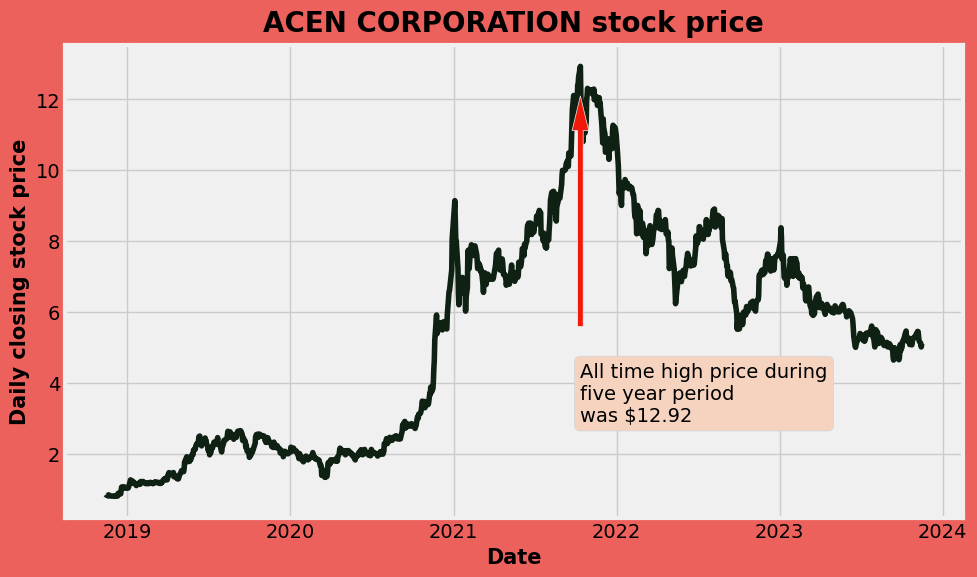

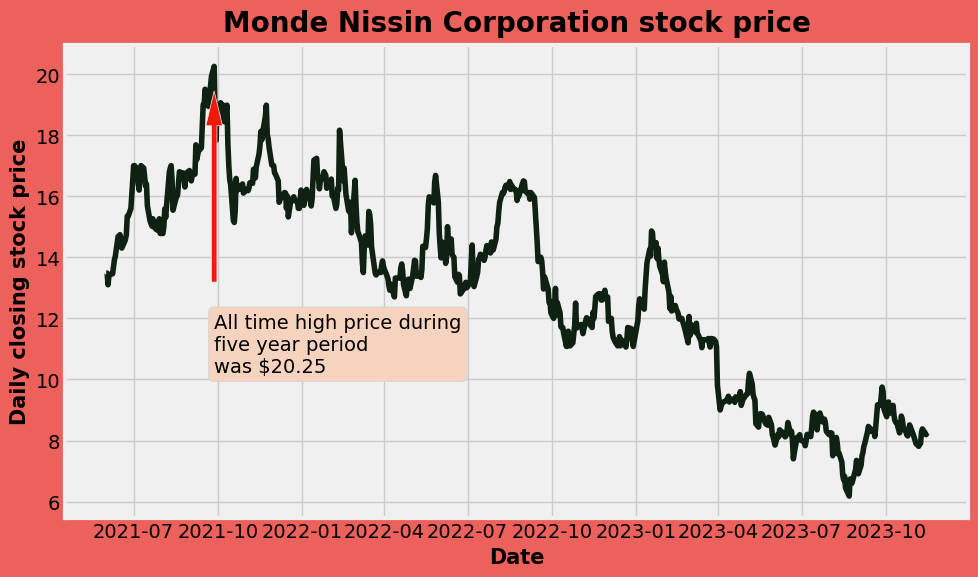

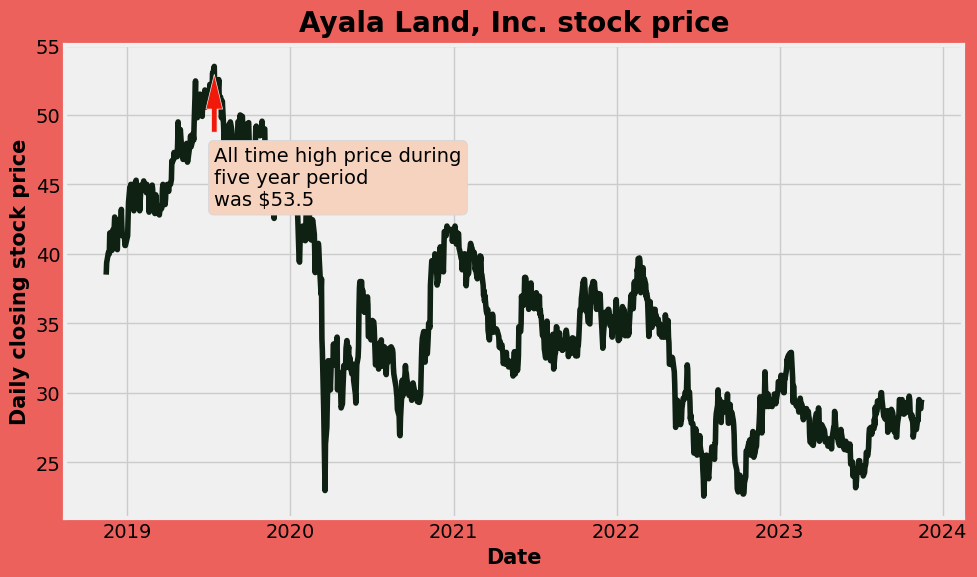

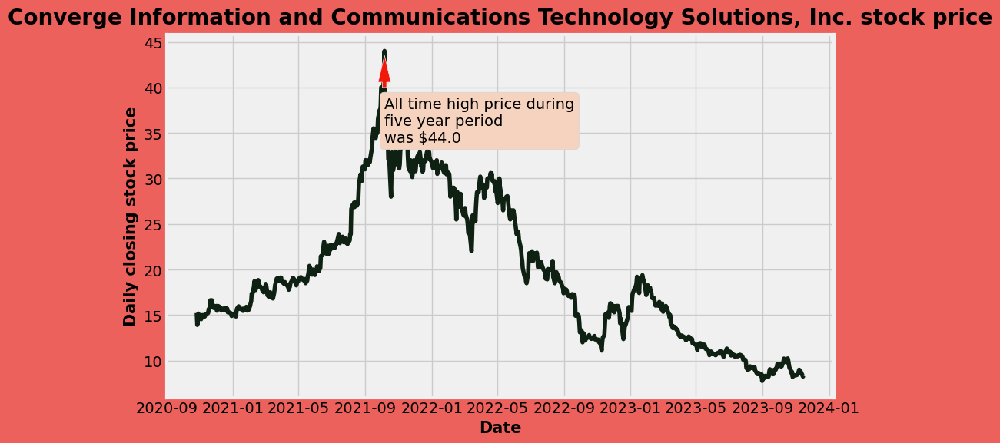

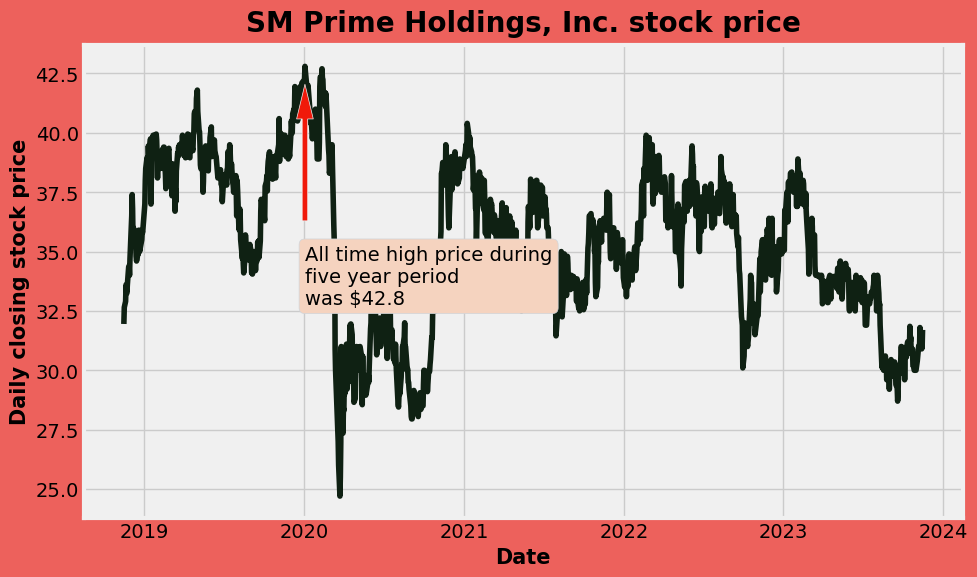

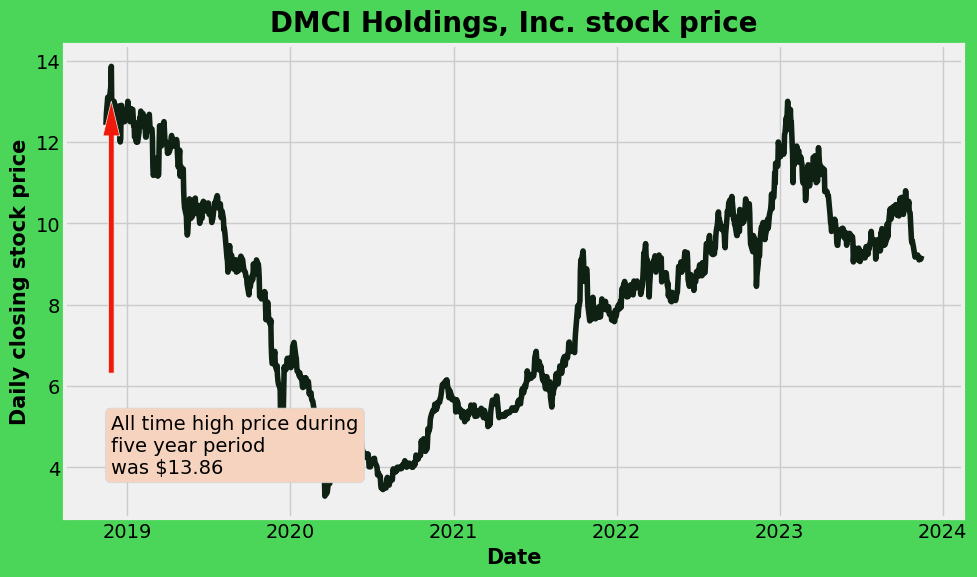

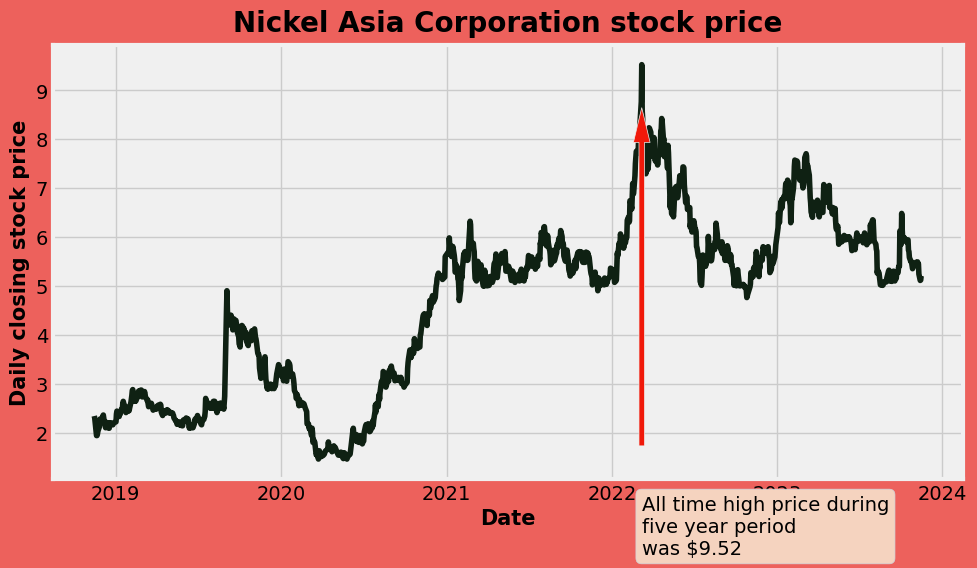

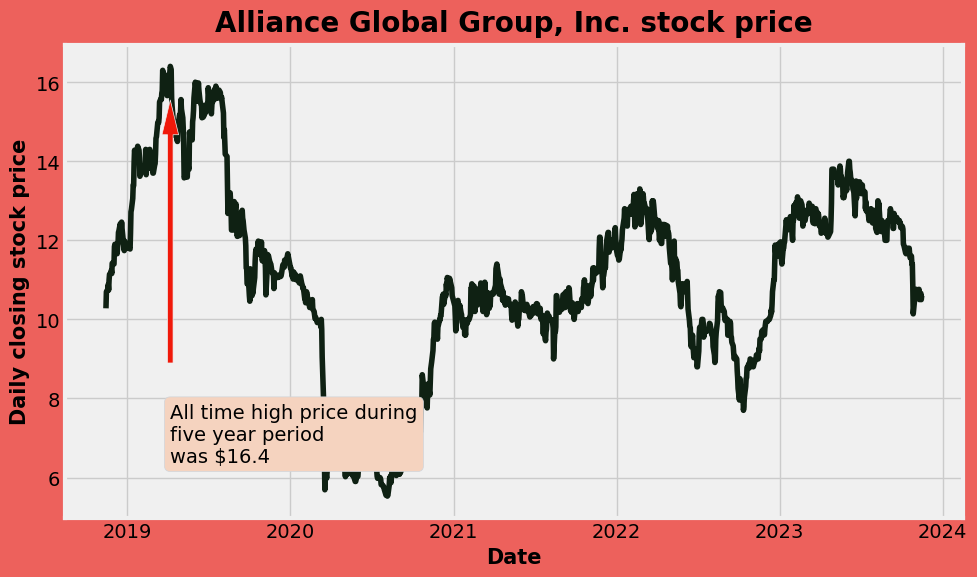

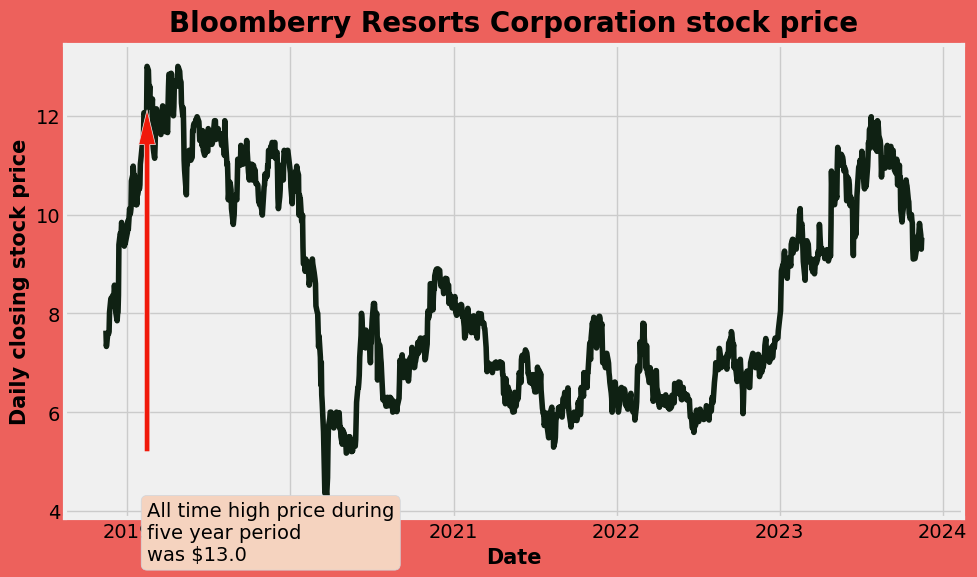

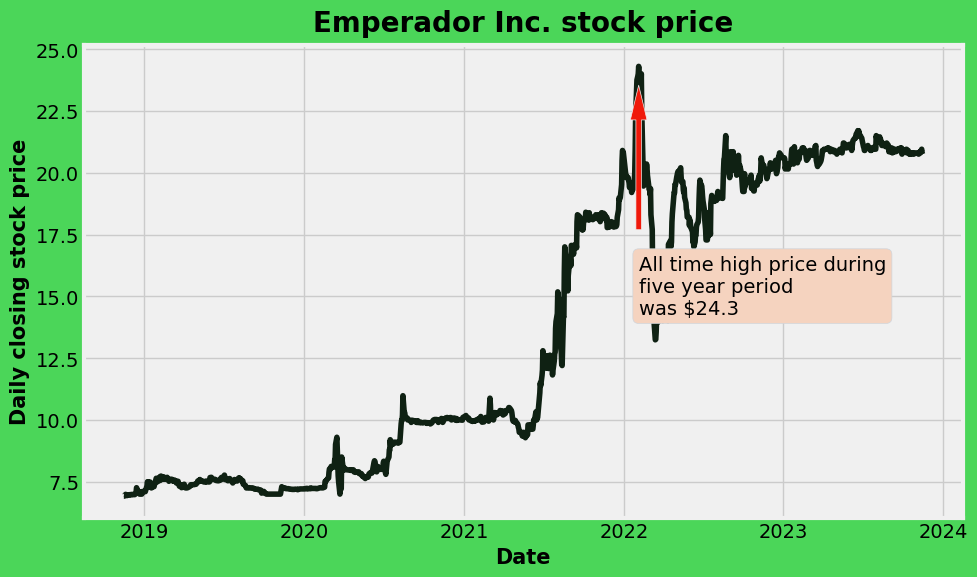

In [ ]:
# function return closing stock price over a 5 years of time period
def closing_stock_price(df):

    # define highest stock over 5 period of time with date of the same
    max_row = df.loc[df['Close'].idxmax()]
    high = max_row['Close']
    datetime = max_row['Date']

    if df['ticks'].unique()[0] == 'ACEN':
        fig, ax = plt.subplots(figsize=(10,6), facecolor='#ed615c')
    elif df['ticks'].unique()[0] == 'MONDE':
        fig, ax = plt.subplots(figsize=(10,6), facecolor='#ed615c')
    elif df['ticks'].unique()[0] == 'ALI':
        fig, ax = plt.subplots(figsize=(10,6), facecolor='#ed615c')
    elif df['ticks'].unique()[0] == 'CNVRG':
        fig, ax = plt.subplots(figsize=(10,6), facecolor='#ed615c')
    elif df['ticks'].unique()[0] == 'SMPH':
        fig, ax = plt.subplots(figsize=(10,6), facecolor='#ed615c')
    elif df['ticks'].unique()[0] == 'DMCI':
        fig, ax = plt.subplots(figsize=(10,6), facecolor='#ed615c')
    elif df['ticks'].unique()[0] == 'NIKL':
        fig, ax = plt.subplots(figsize=(10,6), facecolor='#ed615c')
    elif df['ticks'].unique()[0] == 'AGI':
        fig, ax = plt.subplots(figsize=(10,6), facecolor='#ed615c')
    elif df['ticks'].unique()[0] == 'BLOOM':
        fig, ax = plt.subplots(figsize=(10,6), facecolor='#ed615c')
    else:
        fig, ax = plt.subplots(figsize=(10,6), facecolor='#4bd659')
    ax.plot(df['Date'], df['Close'], color='#0f2113')
    ax.set_title(f"{df['co_name'].unique()[0]} stock price", fontsize=20)
    ax.set_xlabel("Date", fontsize=15)
    ax.set_ylabel("Daily closing stock price", fontsize=15)
    ax.annotate(f"All time high price during\nfive year period\nwas ${high}", xy=(datetime, high),xytext=(datetime,high-10),
                bbox=dict(boxstyle="round",facecolor='#f5d3bf', edgecolor='#d0d5db'),
                arrowprops=dict(facecolor='#f0190a',headlength=25, shrink=0.1))
    plt.show()

# plot of all the closing stocks
closing_stock_price(acen_df)
closing_stock_price(monde_df)
closing_stock_price(ali_df)
closing_stock_price(cnvrg_df)
closing_stock_price(smph_df)
closing_stock_price(dmc_df)
closing_stock_price(nikl_df)
closing_stock_price(agi_df)
closing_stock_price(bloom_df)
closing_stock_price(emi_df)

## Trade volume of stocks over a period of 2018-2023

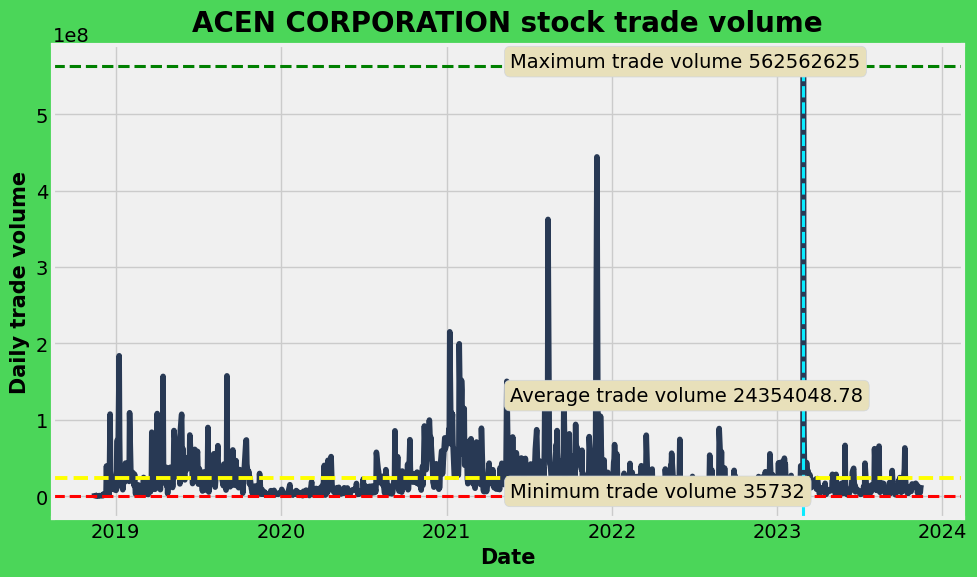

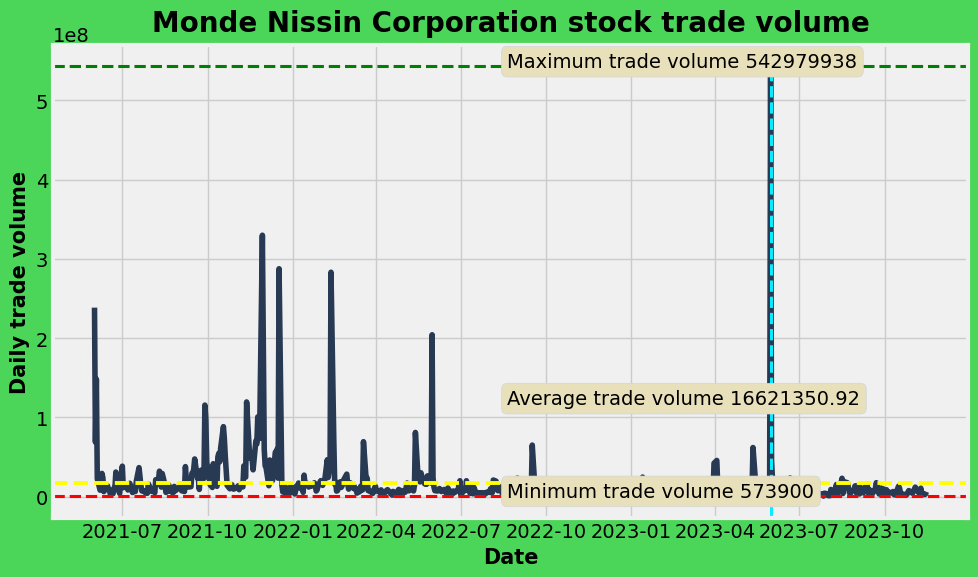

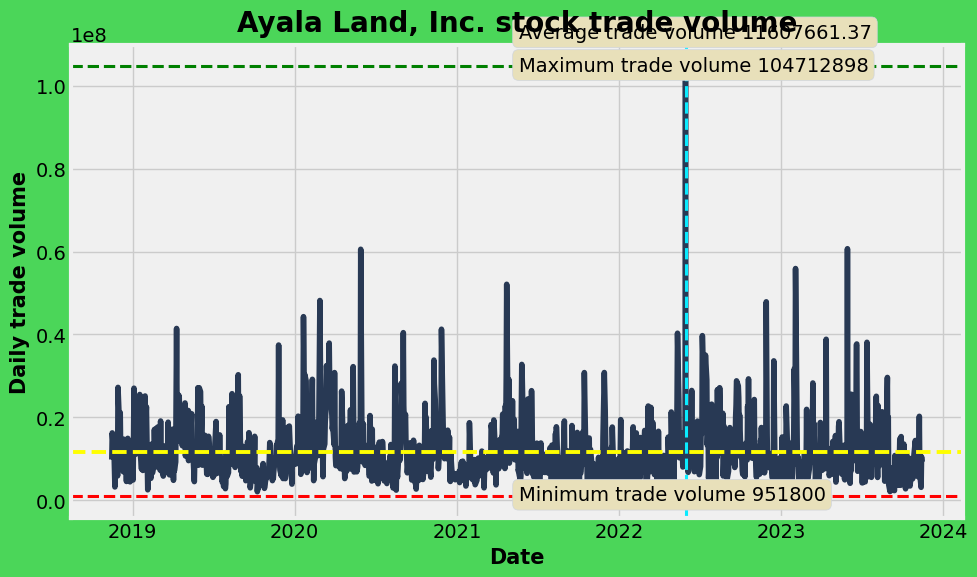

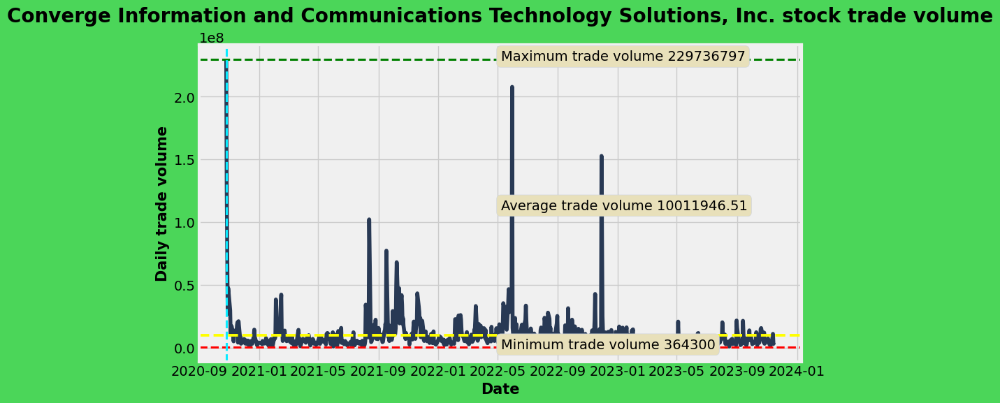

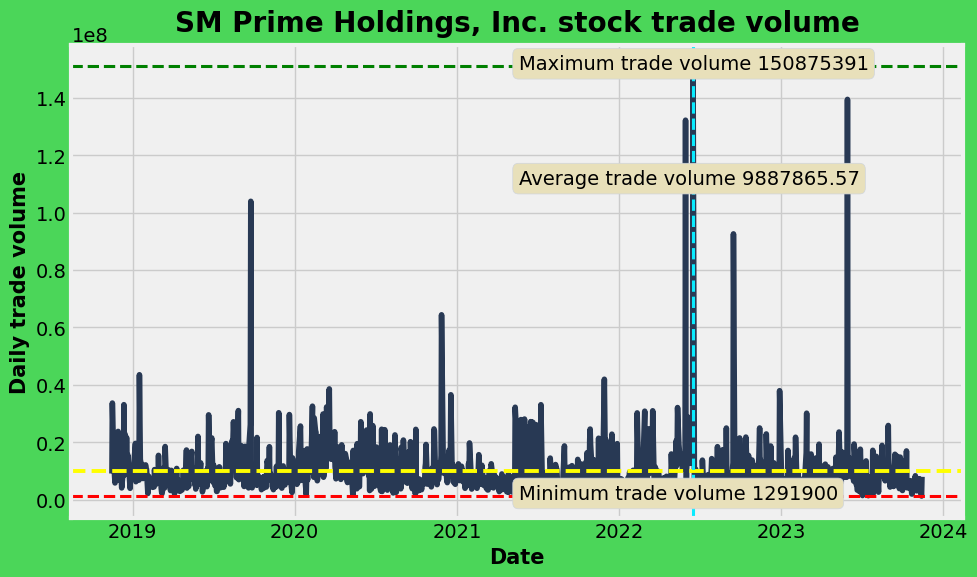

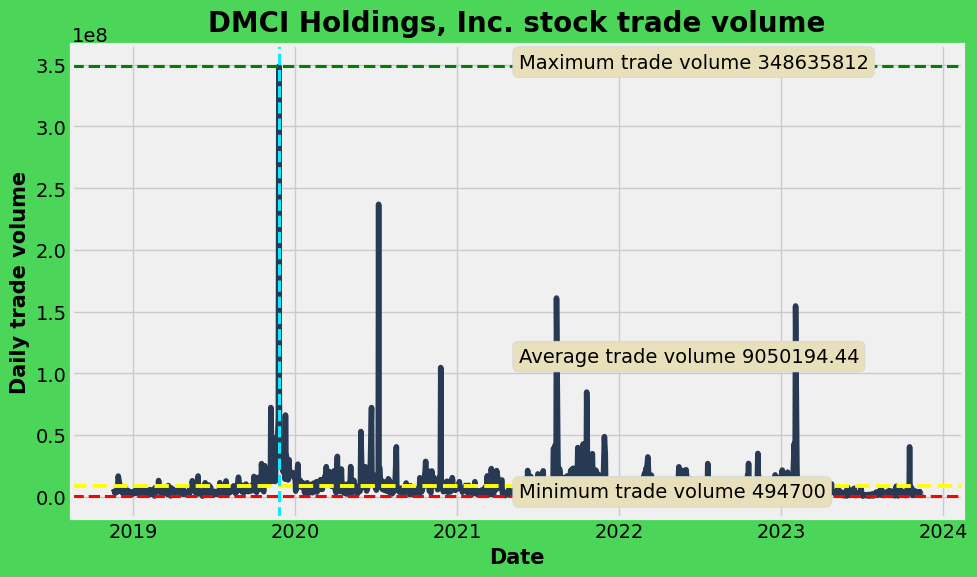

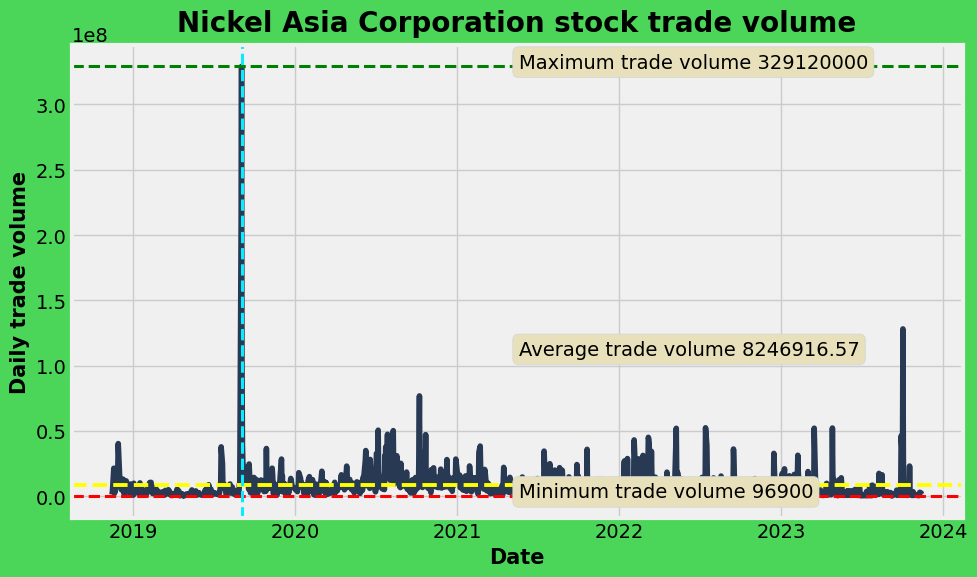

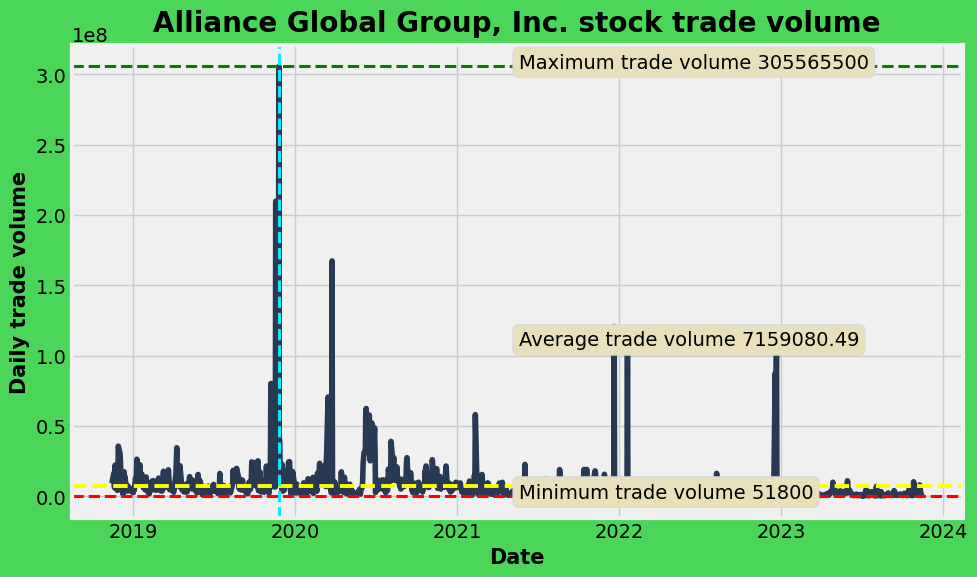

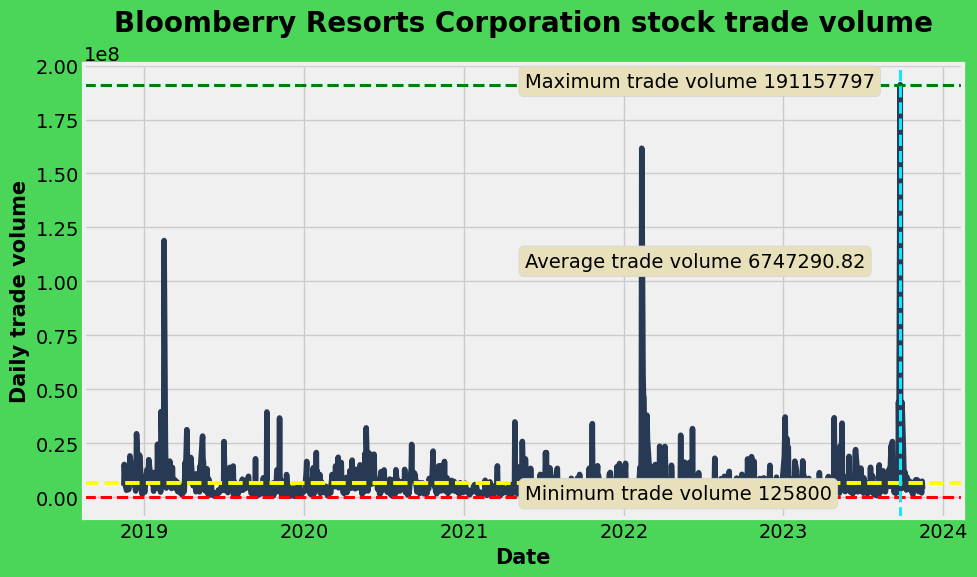

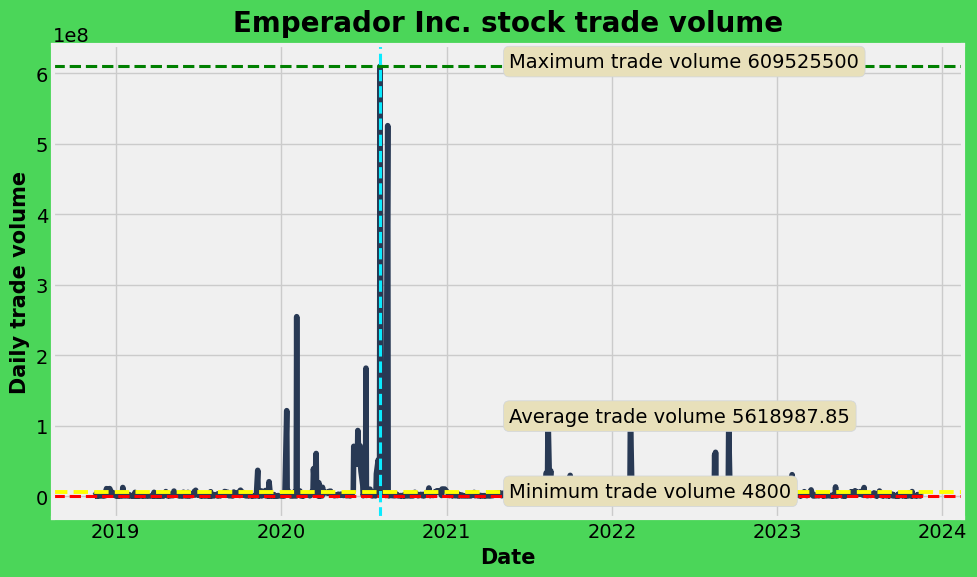

In [ ]:
# function to visualize trade volume of stocks
def trade_vol(df):

    # x and y coords for average trade volume
    ave_x = df['Date'].mean()
    ave_y = df['Volume'].mean()
    # y coord for max trade vol
    max_y = df['Volume'].max()
    # y coord for min trade vol
    min_y = df['Volume'].min()

    fig, ax = plt.subplots(figsize=(10,6), facecolor='#4bd659')
    ax.plot(df['Date'], df['Volume'], color='#283954')
    ax.set_title(f"{df['co_name'].unique()[0]} stock trade volume", fontsize=20)
    ax.set_xlabel("Date", fontsize=15)
    ax.set_ylabel("Daily trade volume", fontsize=15)
    ax.axhline(y=df['Volume'].max(), linestyle='--', lw=2.2, color='green')
    ax.axhline(y=df['Volume'].min(), linestyle='--',lw=2.2, color='red')
    ax.axhline(y=df['Volume'].mean(), linestyle='--',lw=2.8, color='yellow')
    ax.axvline(x=df[df['Volume'] == max_y]['Date'].values, ls='--', lw='2.2', color='#0aebff')
    ax.annotate(f"Average trade volume {round(df['Volume'].mean(),2)}",
                xy=(ave_x,ave_y),xytext=(ave_x ,ave_y + 100000000),
                bbox=dict(boxstyle="round",facecolor='#e8e0ba', edgecolor='#d0d5db')
                 )
    ax.annotate(f"Maximum trade volume {df['Volume'].max()}",
                xy=(ave_x,max_y),xytext=(ave_x,max_y - 1000000),
                bbox=dict(boxstyle="round",facecolor='#e8e0ba', edgecolor='#d0d5db')
                 )
    ax.annotate(f"Minimum trade volume {df['Volume'].min()}",
                xy=(ave_x,min_y),xytext=(ave_x,min_y - 1000000),
                bbox=dict(boxstyle="round",facecolor='#e8e0ba', edgecolor='#d0d5db')
                 )

    plt.show()


# plot of all stocks trade volume
trade_vol(acen_df)
trade_vol(monde_df)
trade_vol(ali_df)
trade_vol(cnvrg_df)
trade_vol(smph_df)
trade_vol(dmc_df)
trade_vol(nikl_df)
trade_vol(agi_df)
trade_vol(bloom_df)
trade_vol(emi_df)

## Find out growth of stocks of the companies over a 5 years period

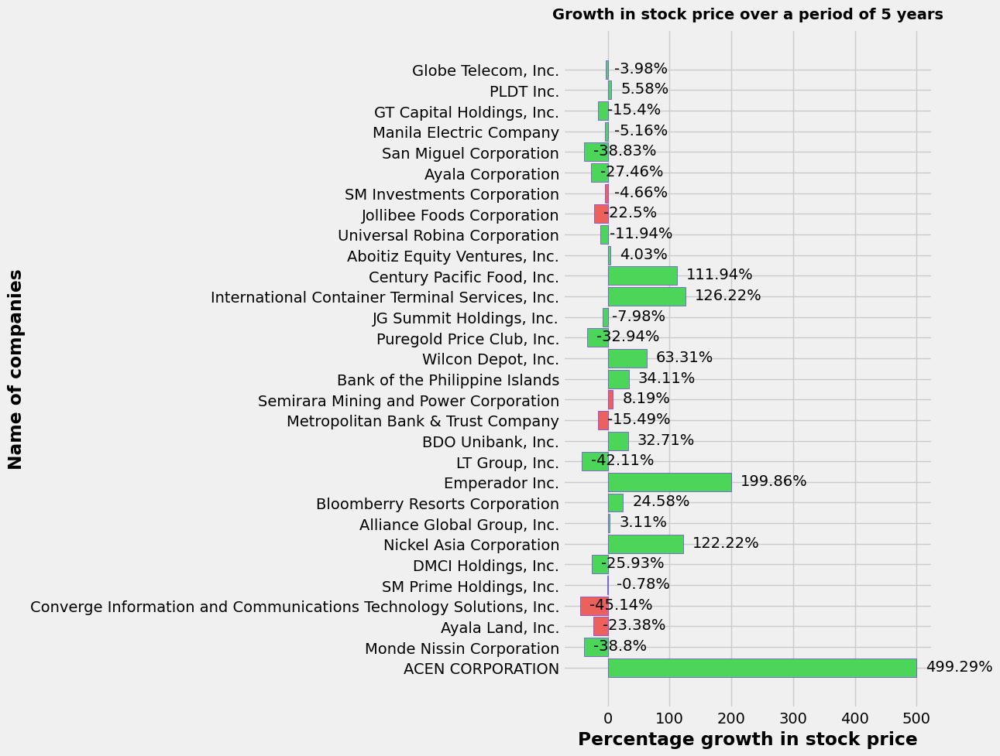

In [ ]:
list_df = [acen_df, monde_df, ali_df, cnvrg_df, smph_df, dmc_df, nikl_df, agi_df, bloom_df, emi_df,
           ltg_df, bdo_df, mbt_df, scc_df, bpi_df, wlcon_df, pgold_df, jgs_df, ict_df, cnpf_df,
           aev_df, urc_df, jfc_df, sm_df, ac_df, smc_df, mer_df, gtcap_df, tel_df, glo_df]

# loop through the the list_df to find mini and maxi of each stocks
mini = [df[df['Date'] == df['Date'].min()]['Close'].values.item() for df in list_df]
maxi = [df[df['Date'] == df['Date'].max()]['Close'].values.item() for df in list_df]

# find list of abosolute difference between both stock price
diff = np.array(maxi) - np.array(mini)

# find the percentage growth
growth = (diff/mini)*100
growth_list = growth.tolist()
co_name_list = [df['co_name'].unique()[0] for df in list_df]

# visualize the growth of the stocks
fig, ax = plt.subplots(figsize=(13,10))
ax.barh(y=co_name_list, width=growth_list, height=0.9, color=['#4bd659','#4bd659','#ed615c','#ed615c','#4bd659',
                                                             '#4bd659','#4bd659','#4bd659','#4bd659','#4bd659'],
       edgecolor='#713ae8')
for p in ax.patches:
    ax.annotate(f'{round(p.get_width(),2)}%', (p.get_width()+15, p.get_y() +0.3))
ax.set_xlabel('Percentage growth in stock price')
ax.set_ylabel('Name of companies')
ax.set_title("Growth in stock price over a period of 5 years")
plt.show()

## Comparative analysis of Financial stocks (BDO,BPI, MBT)

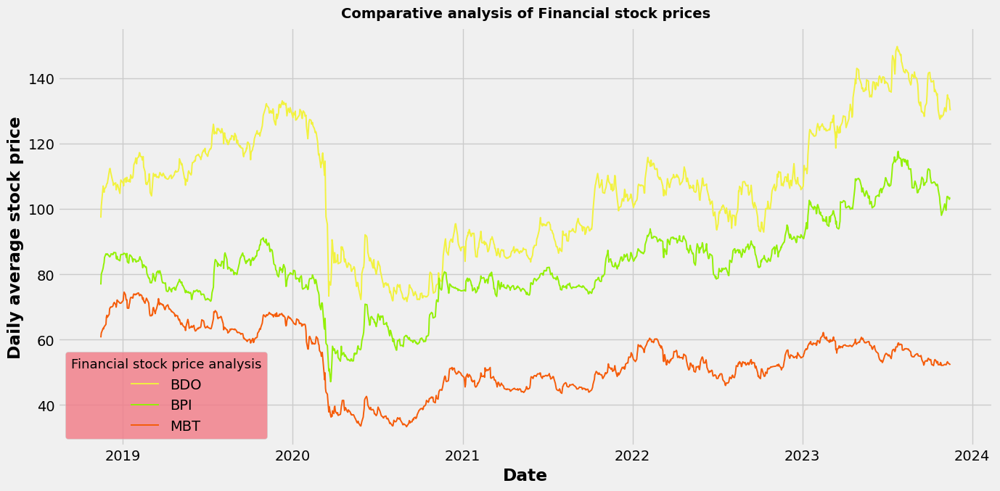

In [ ]:
# tech stocks price comparison
fig, ax = plt.subplots(figsize=(14,7))
ax.plot(bdo_df['Date'], bdo_df['daily_mean'],label='BDO', color='#f2f23f', lw=1.4)
ax.plot(bpi_df['Date'], bpi_df['daily_mean'],label='BPI', color='#92f005', lw=1.4)
ax.plot(mbt_df['Date'], mbt_df['daily_mean'],label='MBT', color='#f55c0a', lw=1.4)
#ax.axvspan(*mdates.datestr2num(['2/1/2016','12/31/2017']), color='#e3aaa6')
ax.set_title("Comparative analysis of Financial stock prices")
#ax.annotate("Years of growth for\nApple,Micron tech and Facebook", xy=(mdates.datestr2num('6/1/2016'),175),
           #bbox=dict(boxstyle="round",facecolor='#e8e0ba', edgecolor='#d0d5db'))
ax.set_xlabel("Date")
ax.set_ylabel("Daily average stock price")
ax.legend(facecolor='#f27985', fontsize="medium", title="Financial stock price analysis", title_fontsize=13)

plt.show()

## Comparative analysis of Industrial stocks (ACEN, CNPF, EMI, JFC, MER, MONDE, URC)

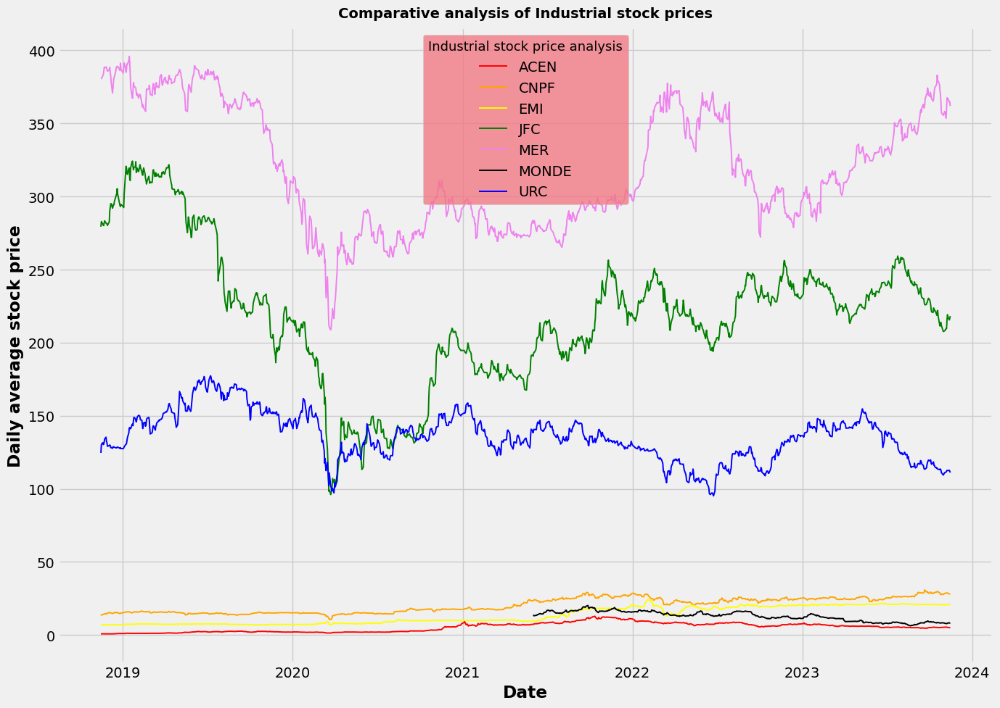

In [ ]:
# tech stocks price comparison
fig, ax = plt.subplots(figsize=(14,10))
ax.plot(acen_df['Date'], acen_df['daily_mean'],label='ACEN', color='RED', lw=1.4)
ax.plot(cnpf_df['Date'], cnpf_df['daily_mean'],label='CNPF', color='ORANGE', lw=1.4)
ax.plot(emi_df['Date'], emi_df['daily_mean'],label='EMI', color='YELLOW', lw=1.4)
ax.plot(jfc_df['Date'], jfc_df['daily_mean'],label='JFC', color='GREEN', lw=1.4)
ax.plot(mer_df['Date'], mer_df['daily_mean'],label='MER', color='VIOLET', lw=1.4)
ax.plot(monde_df['Date'], monde_df['daily_mean'],label='MONDE', color='BLACK', lw=1.4)
ax.plot(urc_df['Date'], urc_df['daily_mean'],label='URC', color='BLUE', lw=1.4)
#ax.axvspan(*mdates.datestr2num(['2/1/2016','12/31/2017']), color='#e3aaa6')
ax.set_title("Comparative analysis of Industrial stock prices")
#ax.annotate("Years of growth for\nApple,Micron tech and Facebook", xy=(mdates.datestr2num('6/1/2016'),175),
           #bbox=dict(boxstyle="round",facecolor='#e8e0ba', edgecolor='#d0d5db'))
ax.set_xlabel("Date")
ax.set_ylabel("Daily average stock price")
ax.legend(facecolor='#f27985', fontsize="medium", title="Industrial stock price analysis", title_fontsize=13)

plt.show()

## Comparative analysis of Holding Firms stocks (AC, AEV, AGI, DMC, GTCAP, JGS, LTG, SM, SMC)

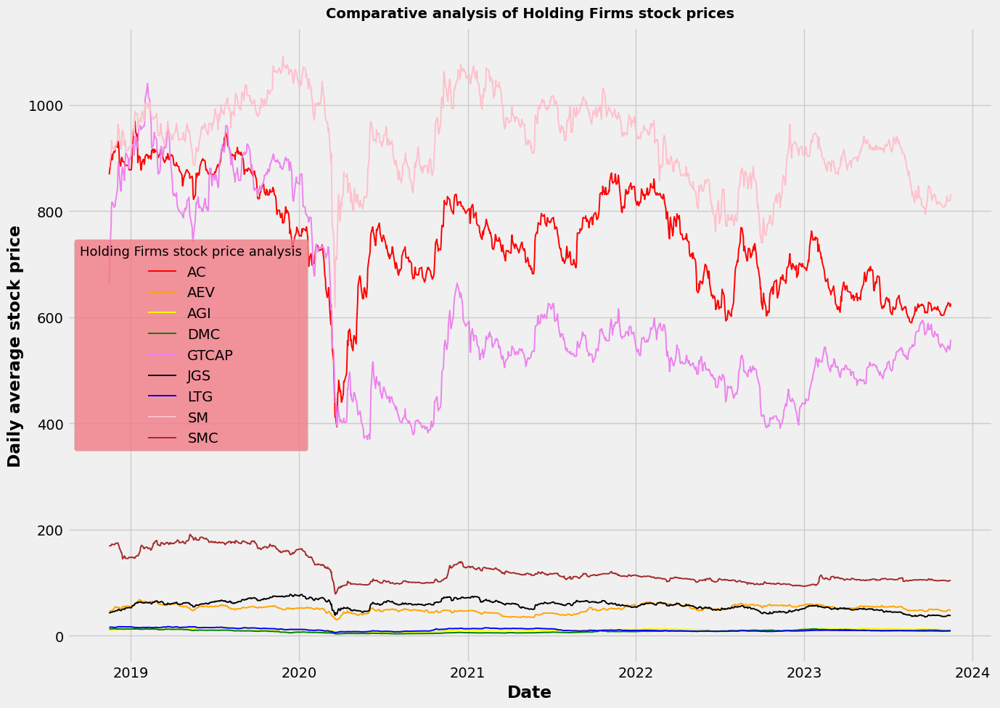

In [ ]:
# tech stocks price comparison
fig, ax = plt.subplots(figsize=(14,10))
ax.plot(ac_df['Date'], ac_df['daily_mean'],label='AC', color='RED', lw=1.4)
ax.plot(aev_df['Date'], aev_df['daily_mean'],label='AEV', color='ORANGE', lw=1.4)
ax.plot(agi_df['Date'], agi_df['daily_mean'],label='AGI', color='YELLOW', lw=1.4)
ax.plot(dmc_df['Date'], dmc_df['daily_mean'],label='DMC', color='GREEN', lw=1.4)
ax.plot(gtcap_df['Date'], gtcap_df['daily_mean'],label='GTCAP', color='VIOLET', lw=1.4)
ax.plot(jgs_df['Date'], jgs_df['daily_mean'],label='JGS', color='BLACK', lw=1.4)
ax.plot(ltg_df['Date'], ltg_df['daily_mean'],label='LTG', color='BLUE', lw=1.4)
ax.plot(sm_df['Date'], sm_df['daily_mean'],label='SM', color='PINK', lw=1.4)
ax.plot(smc_df['Date'], smc_df['daily_mean'],label='SMC', color='BROWN', lw=1.4)
#ax.axvspan(*mdates.datestr2num(['2/1/2016','12/31/2017']), color='#e3aaa6')
ax.set_title("Comparative analysis of Holding Firms stock prices")
#ax.annotate("Years of growth for\nApple,Micron tech and Facebook", xy=(mdates.datestr2num('6/1/2016'),175),
           #bbox=dict(boxstyle="round",facecolor='#e8e0ba', edgecolor='#d0d5db'))
ax.set_xlabel("Date")
ax.set_ylabel("Daily average stock price")
ax.legend(facecolor='#f27985', fontsize="medium", title="Holding Firms stock price analysis", title_fontsize=13)

plt.show()

## Comparative analysis of Property stocks (ALI, SMPH)

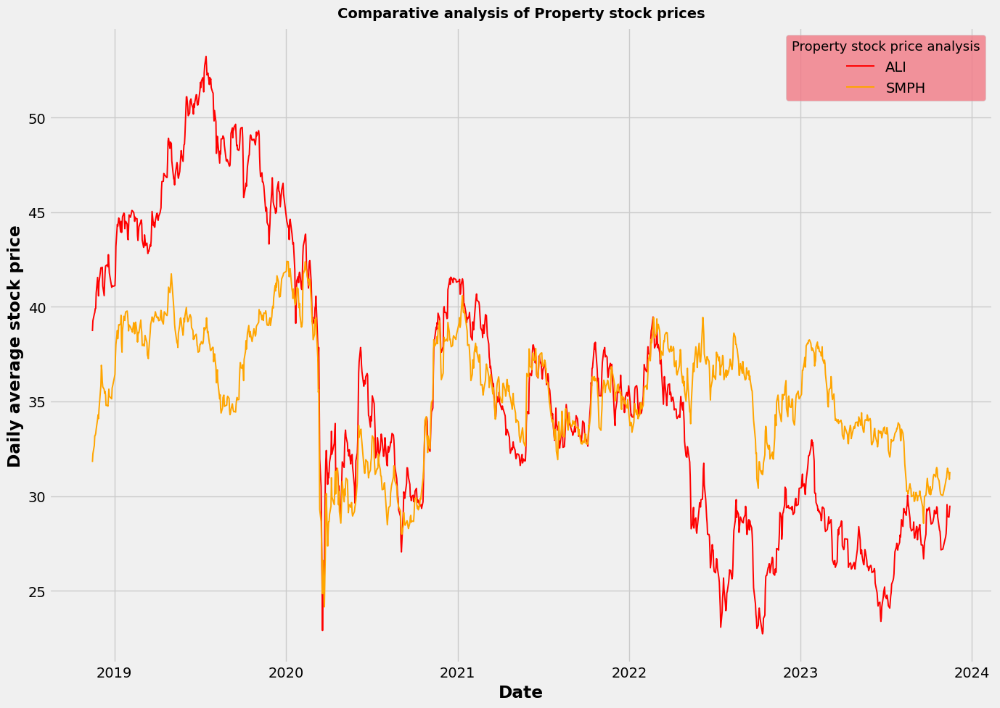

In [ ]:
# tech stocks price comparison
fig, ax = plt.subplots(figsize=(14,10))
ax.plot(ali_df['Date'], ali_df['daily_mean'],label='ALI', color='RED', lw=1.4)
ax.plot(smph_df['Date'], smph_df['daily_mean'],label='SMPH', color='ORANGE', lw=1.4)
#ax.axvspan(*mdates.datestr2num(['2/1/2016','12/31/2017']), color='#e3aaa6')
ax.set_title("Comparative analysis of Property stock prices")
#ax.annotate("Years of growth for\nApple,Micron tech and Facebook", xy=(mdates.datestr2num('6/1/2016'),175),
           #bbox=dict(boxstyle="round",facecolor='#e8e0ba', edgecolor='#d0d5db'))
ax.set_xlabel("Date")
ax.set_ylabel("Daily average stock price")
ax.legend(facecolor='#f27985', fontsize="medium", title="Property stock price analysis", title_fontsize=13)

plt.show()

## Comparative analysis of Services stocks (BLOOM, CNVRG, GLO, ICT, PGOLD, TEL, WLCON)

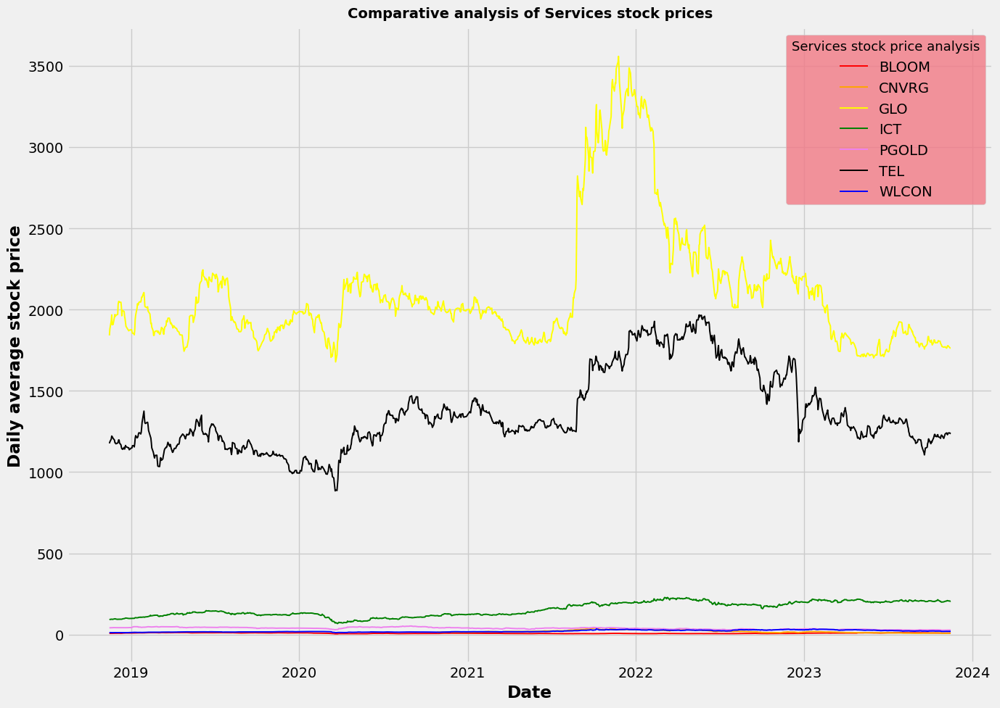

In [ ]:
# tech stocks price comparison
fig, ax = plt.subplots(figsize=(14,10))
ax.plot(bloom_df['Date'], bloom_df['daily_mean'],label='BLOOM', color='RED', lw=1.4)
ax.plot(cnvrg_df['Date'], cnvrg_df['daily_mean'],label='CNVRG', color='ORANGE', lw=1.4)
ax.plot(glo_df['Date'], glo_df['daily_mean'],label='GLO', color='YELLOW', lw=1.4)
ax.plot(ict_df['Date'], ict_df['daily_mean'],label='ICT', color='GREEN', lw=1.4)
ax.plot(pgold_df['Date'], pgold_df['daily_mean'],label='PGOLD', color='VIOLET', lw=1.4)
ax.plot(tel_df['Date'], tel_df['daily_mean'],label='TEL', color='BLACK', lw=1.4)
ax.plot(wlcon_df['Date'], wlcon_df['daily_mean'],label='WLCON', color='BLUE', lw=1.4)
#ax.axvspan(*mdates.datestr2num(['2/1/2016','12/31/2017']), color='#e3aaa6')
ax.set_title("Comparative analysis of Services stock prices")
#ax.annotate("Years of growth for\nApple,Micron tech and Facebook", xy=(mdates.datestr2num('6/1/2016'),175),
           #bbox=dict(boxstyle="round",facecolor='#e8e0ba', edgecolor='#d0d5db'))
ax.set_xlabel("Date")
ax.set_ylabel("Daily average stock price")
ax.legend(facecolor='#f27985', fontsize="medium", title="Services stock price analysis", title_fontsize=13)

plt.show()

## Comparative analysis of Mining & Oil stocks (SCC, NIKL, )

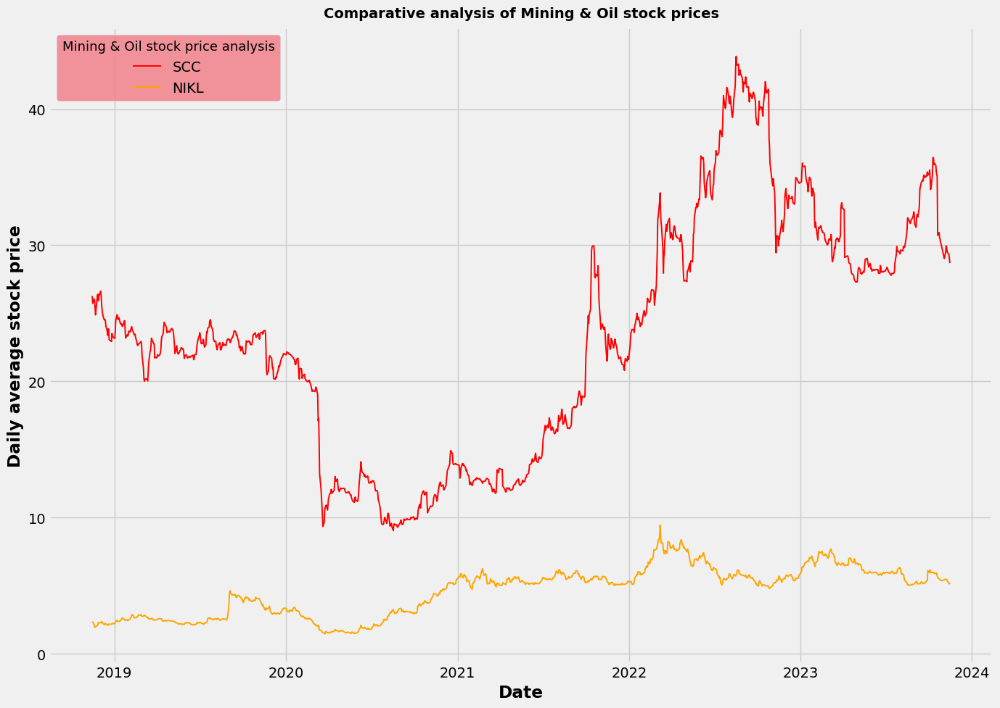

In [ ]:
# tech stocks price comparison
fig, ax = plt.subplots(figsize=(14,10))
ax.plot(scc_df['Date'], scc_df['daily_mean'],label='SCC', color='RED', lw=1.4)
ax.plot(nikl_df['Date'], nikl_df['daily_mean'],label='NIKL', color='ORANGE', lw=1.4)
#ax.axvspan(*mdates.datestr2num(['2/1/2016','12/31/2017']), color='#e3aaa6')
ax.set_title("Comparative analysis of Mining & Oil stock prices")
#ax.annotate("Years of growth for\nApple,Micron tech and Facebook", xy=(mdates.datestr2num('6/1/2016'),175),
           #bbox=dict(boxstyle="round",facecolor='#e8e0ba', edgecolor='#d0d5db'))
ax.set_xlabel("Date")
ax.set_ylabel("Daily average stock price")
ax.legend(facecolor='#f27985', fontsize="medium", title="Mining & Oil stock price analysis", title_fontsize=13)

plt.show()

## Candlestick charts of stocks to visualize OHLC prices

In [ ]:
# using plotly graph_objs let's plot candlestick charts of stocks
def candlestick_chart(df):
    trace = go.Candlestick(x=df['Date'],
                          open=df['Open'],
                          high=df['High'],
                          low=df['Low'],
                          close=df['Close'])
    layout ={
    'title': f"{df['co_name'].unique()[0]} Historical Stock Price",
    'xaxis': {'title': 'Date'
             },
    'yaxis': {'title': 'Stock Price (PHP)'}
}


    data = [trace]

    fig = go.Figure(data=data, layout=layout)
    fig.update_layout(xaxis_rangeslider_visible=False, paper_bgcolor='#4bd659')
    fig.show()

# plot the charts using this function
candlestick_chart(acen_df)
candlestick_chart(monde_df)
candlestick_chart(ali_df)
candlestick_chart(cnvrg_df)
candlestick_chart(smph_df)
candlestick_chart(dmc_df)
candlestick_chart(nikl_df)
candlestick_chart(agi_df)
candlestick_chart(bloom_df)
candlestick_chart(emi_df)
candlestick_chart(ltg_df)
candlestick_chart(bdo_df)
candlestick_chart(mbt_df)
candlestick_chart(scc_df)
candlestick_chart(bpi_df)
candlestick_chart(wlcon_df)
candlestick_chart(pgold_df)
candlestick_chart(jgs_df)
candlestick_chart(ict_df)
candlestick_chart(cnpf_df)
candlestick_chart(aev_df)
candlestick_chart(urc_df)
candlestick_chart(jfc_df)
candlestick_chart(sm_df)
candlestick_chart(ac_df)
candlestick_chart(smc_df)
candlestick_chart(mer_df)
candlestick_chart(gtcap_df)
candlestick_chart(tel_df)
candlestick_chart(glo_df)

## Moving Averages charts

In [ ]:
# define function to return copies of stock dataframe with moving averages
def mav_function(df):

    # calclulate moving averages of 10,50 and 200 days
    df['10_d_avg'] = df['Close'].rolling(window=10).mean()
    df['50_d_avg'] = df['Close'].rolling(window=50).mean()
    df['200_d_avg'] = df['Close'].rolling(window=200).mean()

    return df

# let's analyse apple and facebook stocks using moving averages methods
acen_df = mav_function(acen_df)
monde_df = mav_function(monde_df)
ali_df = mav_function(ali_df)
cnvrg_df = mav_function(cnvrg_df)
smph_df = mav_function(smph_df)
dmc_df = mav_function(dmc_df)
nikl_df = mav_function(nikl_df)
agi_df = mav_function(agi_df)
bloom_df = mav_function(bloom_df)
emi_df = mav_function(emi_df)
ltg_df = mav_function(ltg_df)
bdo_df = mav_function(bdo_df)
mbt_df = mav_function(mbt_df)
scc_df = mav_function(scc_df)
bpi_df = mav_function(bpi_df)
wlcon_df = mav_function(wlcon_df)
pgold_df = mav_function(pgold_df)
jgs_df = mav_function(jgs_df)
ict_df = mav_function(ict_df)
cnpf_df = mav_function(cnpf_df)
aev_df = mav_function(aev_df)
urc_df = mav_function(urc_df)
jfc_df = mav_function(jfc_df)
sm_df = mav_function(sm_df)
ac_df = mav_function(ac_df)
smc_df = mav_function(smc_df)
mer_df = mav_function(mer_df)
gtcap_df = mav_function(gtcap_df)
tel_df = mav_function(tel_df)
glo_df = mav_function(glo_df)

In [ ]:
acen_dfn = acen_df.copy()
monde_dfn = monde_df.copy()
ali_dfn = ali_df.copy()
cnvrg_dfn = cnvrg_df.copy()
smph_dfn = smph_df.copy()
dmc_dfn = dmc_df.copy()
nikl_dfn = nikl_df.copy()
agi_dfn = agi_df.copy()
bloom_dfn = bloom_df.copy()
emi_dfn = emi_df.copy()
ltg_dfn = ltg_df.copy()
bdo_dfn = bdo_df.copy()
mbt_dfn = mbt_df.copy()
scc_dfn = scc_df.copy()
bpi_dfn = bpi_df.copy()
wlcon_dfn = wlcon_df.copy()
pgold_dfn = pgold_df.copy()
jgs_dfn = jgs_df.copy()
ict_dfn = ict_df.copy()
cnpf_dfn = cnpf_df.copy()
aev_dfn = aev_df.copy()
urc_dfn = urc_df.copy()
jfc_dfn = jfc_df.copy()
sm_dfn = sm_df.copy()
ac_dfn = ac_df.copy()
smc_dfn = smc_df.copy()
mer_dfn = mer_df.copy()
gtcap_dfn = gtcap_df.copy()
tel_dfn = tel_df.copy()
glo_dfn = glo_df.copy()

def mav_chart(df):
    df = df.set_index('Date')

    fig = tls.make_subplots(rows=2, cols=1, shared_xaxes=True)
    # set colors and cols names to be plotted
    colors = ['#ff4500', '#92a1cf', '#6E6E6E']
    avgs = ['10_d_avg','50_d_avg','200_d_avg']

    for col, c in zip(avgs, colors):
        fig.append_trace({'x': df.index, 'y': df[col], 'type': 'scatter', 'name': col, 'line': {'color': c}},1,1)
    for col in ['Close']:
        fig.append_trace({'x': df.index, 'y': df[col], 'type': 'scatter', 'name': 'closing price', 'line': {'color': '#393f5e'}},2,1)

    fig['layout'].update(height=800,title=f"Relationship between Moving averages <br> and Closing Price of {df['co_name'].unique()[0]}",
                    paper_bgcolor='#4bd659', plot_bgcolor='#F2DFCE')
    fig.show()

In [ ]:
mav_chart(acen_dfn)

In [ ]:
mav_chart(monde_dfn)

In [ ]:
mav_chart(ali_dfn)


In [ ]:
mav_chart(cnvrg_dfn)


In [ ]:
mav_chart(smph_dfn)


In [ ]:
mav_chart(dmc_dfn)


In [ ]:
mav_chart(nikl_dfn)


In [ ]:
mav_chart(agi_dfn)


In [ ]:
mav_chart(bloom_dfn)


In [ ]:
mav_chart(emi_dfn)


In [ ]:
mav_chart(ltg_dfn)


In [ ]:
mav_chart(bdo_dfn)


In [ ]:
mav_chart(mbt_dfn)


In [ ]:
mav_chart(scc_dfn)


In [ ]:
mav_chart(bpi_dfn)


In [ ]:
mav_chart(wlcon_dfn)


In [ ]:
mav_chart(pgold_dfn)


In [ ]:
mav_chart(jgs_dfn)


In [ ]:
mav_chart(ict_dfn)


In [ ]:
mav_chart(cnpf_dfn)


In [ ]:
mav_chart(aev_dfn)


In [ ]:
mav_chart(urc_dfn)


In [ ]:
mav_chart(jfc_dfn)


In [ ]:
mav_chart(sm_dfn)


In [ ]:
mav_chart(ac_dfn)


In [ ]:
mav_chart(smc_dfn)


In [ ]:
mav_chart(mer_dfn)


In [ ]:
mav_chart(gtcap_dfn)


In [ ]:
mav_chart(tel_dfn)


In [ ]:
mav_chart(glo_dfn)

In [ ]:
df[df['Name']=='BDO'].head()

,Date,Open,High,Low,Close,Volume,Name
6096,2018-11-15,95.833,99.167,95.833,98.333,1001664,BDO
6097,2018-11-16,98.333,103.333,98.333,103.333,3489264,BDO
6098,2018-11-19,102.917,108.083,102.750,108.083,3276792,BDO
6099,2018-11-20,106.833,108.333,105.083,107.750,3047568,BDO
6100,2018-11-21,105.500,107.417,105.000,105.833,1888608,BDO


### Month to date

In [ ]:
def calculate_mtd_return(df):
    latest_date = df['Date'].max()
    start_of_month = latest_date.replace(day=1)

    # Filter data for month-to-date
    mtd_data = df[(df['Date'] >= start_of_month) & (df['Date'] <= latest_date)]

    if not mtd_data.empty:
        start_of_month_close = mtd_data.loc[mtd_data['Date'].idxmin(), 'Close']
        latest_close = mtd_data.loc[mtd_data['Date'].idxmax(), 'Close']
        mtd_return = ((latest_close - start_of_month_close) / start_of_month_close) * 100
        return mtd_return
    else:
        return None

stock_dataframes = {'ac_df': ac_df, 'acen_df': acen_df, 'aev_df': aev_df, 'agi_df': agi_df,
                    'ali_df': ali_df, 'bdo_df': bdo_df, 'bloom_df': bloom_df, 'bpi_df': bpi_df,
                    'cnpf_df': cnpf_df, 'cnvrg_df': cnvrg_df, 'dmc_df': dmc_df, 'emi_df': emi_df,
                    'glo_df': glo_df, 'gtcap_df': gtcap_df, 'ict_df': ict_df, 'jfc_df': jfc_df,
                    'jgs_df': jgs_df, 'ltg_df': ltg_df, 'mbt_df': mbt_df, 'mer_df': mer_df,
                    'monde_df': monde_df, 'nikl_df': nikl_df, 'pgold_df': pgold_df, 'scc_df': scc_df,
                    'sm_df': sm_df, 'smc_df': smc_df, 'smph_df': smph_df, 'tel_df': tel_df,
                    'urc_df': urc_df, 'wlcon_df': wlcon_df}

# Calculate MTD returns for each DataFrame
mtd_returns = {name: calculate_mtd_return(df) for name, df in stock_dataframes.items()}

# Remove entries with None (no data)
mtd_returns = {name: value for name, value in mtd_returns.items() if value is not None}

# Sort the results in descending order
sorted_mtd_returns = dict(sorted(mtd_returns.items(), key=lambda item: item[1], reverse=True))

# Print the sorted results
for name, mtd_return in sorted_mtd_returns.items():
    print(f"Month-to-date return for {name}: {mtd_return:.2f}%")


Month-to-date return for jgs_df: 8.48%
Month-to-date return for ali_df: 7.86%
Month-to-date return for gtcap_df: 6.82%
Month-to-date return for bpi_df: 5.00%
Month-to-date return for aev_df: 4.49%
Month-to-date return for monde_df: 4.43%
Month-to-date return for ltg_df: 4.32%
Month-to-date return for smph_df: 4.28%
Month-to-date return for sm_df: 4.22%
Month-to-date return for jfc_df: 3.83%
Month-to-date return for bloom_df: 2.69%
Month-to-date return for ac_df: 2.44%
Month-to-date return for bdo_df: 1.95%
Month-to-date return for ict_df: 1.85%
Month-to-date return for pgold_df: 1.81%
Month-to-date return for mer_df: 1.41%
Month-to-date return for urc_df: 1.18%
Month-to-date return for smc_df: 0.49%
Month-to-date return for mbt_df: 0.38%
Month-to-date return for dmc_df: 0.22%
Month-to-date return for glo_df: 0.00%
Month-to-date return for emi_df: -0.24%
Month-to-date return for tel_df: -0.73%
Month-to-date return for wlcon_df: -0.74%
Month-to-date return for cnpf_df: -0.87%
Month-to-da

### Year to date

In [ ]:
def calculate_ytd_return(df):
    latest_date = df['Date'].max()
    start_of_year = latest_date.replace(month=1, day=1)

    # Filter data for year-to-date
    ytd_data = df[(df['Date'] >= start_of_year) & (df['Date'] <= latest_date)]

    if not ytd_data.empty:
        start_of_year_close = ytd_data.loc[ytd_data['Date'].idxmin(), 'Close']
        latest_close = ytd_data.loc[ytd_data['Date'].idxmax(), 'Close']
        ytd_return = ((latest_close - start_of_year_close) / start_of_year_close) * 100
        return ytd_return
    else:
        return None

stock_dataframes = {'ac_df': ac_df, 'acen_df': acen_df, 'aev_df': aev_df, 'agi_df': agi_df,
                    'ali_df': ali_df, 'bdo_df': bdo_df, 'bloom_df': bloom_df, 'bpi_df': bpi_df,
                    'cnpf_df': cnpf_df, 'cnvrg_df': cnvrg_df, 'dmc_df': dmc_df, 'emi_df': emi_df,
                    'glo_df': glo_df, 'gtcap_df': gtcap_df, 'ict_df': ict_df, 'jfc_df': jfc_df,
                    'jgs_df': jgs_df, 'ltg_df': ltg_df, 'mbt_df': mbt_df, 'mer_df': mer_df,
                    'monde_df': monde_df, 'nikl_df': nikl_df, 'pgold_df': pgold_df, 'scc_df': scc_df,
                    'sm_df': sm_df, 'smc_df': smc_df, 'smph_df': smph_df, 'tel_df': tel_df,
                    'urc_df': urc_df, 'wlcon_df': wlcon_df}

# Calculate YTD returns for each DataFrame
ytd_returns = {name: calculate_ytd_return(df) for name, df in stock_dataframes.items()}

# Remove entries with None (no data)
ytd_returns = {name: value for name, value in ytd_returns.items() if value is not None}

# Sort the results in descending order
sorted_ytd_returns = dict(sorted(ytd_returns.items(), key=lambda item: item[1], reverse=True))

# Print the sorted results
for name, ytd_return in sorted_ytd_returns.items():
    print(f"Year-to-date return for {name}: {ytd_return:.2f}%")


Year-to-date return for gtcap_df: 28.53%
Year-to-date return for bdo_df: 20.95%
Year-to-date return for mer_df: 19.28%
Year-to-date return for bloom_df: 18.39%
Year-to-date return for bpi_df: 15.64%
Year-to-date return for smc_df: 11.29%
Year-to-date return for cnpf_df: 10.51%
Year-to-date return for ict_df: 5.45%
Year-to-date return for emi_df: 0.73%
Year-to-date return for ltg_df: -1.29%
Year-to-date return for ali_df: -2.96%
Year-to-date return for mbt_df: -5.61%
Year-to-date return for sm_df: -6.78%
Year-to-date return for jfc_df: -8.05%
Year-to-date return for ac_df: -8.22%
Year-to-date return for tel_df: -9.23%
Year-to-date return for smph_df: -9.56%
Year-to-date return for agi_df: -11.37%
Year-to-date return for nikl_df: -15.99%
Year-to-date return for aev_df: -17.24%
Year-to-date return for urc_df: -17.42%
Year-to-date return for scc_df: -18.51%
Year-to-date return for pgold_df: -19.25%
Year-to-date return for glo_df: -20.63%
Year-to-date return for dmc_df: -20.96%
Year-to-date

### 7 Day

In [ ]:
def calculate_7day_return(df):
    latest_date = df['Date'].max()
    start_of_7days_ago = latest_date - pd.DateOffset(days=7)

    # Filter data for the last 7 days
    last_7days_data = df[(df['Date'] >= start_of_7days_ago) & (df['Date'] <= latest_date)]

    if not last_7days_data.empty:
        start_7days_ago_close = last_7days_data.loc[last_7days_data['Date'].idxmin(), 'Close']
        latest_close = last_7days_data.loc[last_7days_data['Date'].idxmax(), 'Close']
        return_7days = ((latest_close - start_7days_ago_close) / start_7days_ago_close) * 100
        return return_7days
    else:
        return None

stock_dataframes = {'ac_df': ac_df, 'acen_df': acen_df, 'aev_df': aev_df, 'agi_df': agi_df,
                    'ali_df': ali_df, 'bdo_df': bdo_df, 'bloom_df': bloom_df, 'bpi_df': bpi_df,
                    'cnpf_df': cnpf_df, 'cnvrg_df': cnvrg_df, 'dmc_df': dmc_df, 'emi_df': emi_df,
                    'glo_df': glo_df, 'gtcap_df': gtcap_df, 'ict_df': ict_df, 'jfc_df': jfc_df,
                    'jgs_df': jgs_df, 'ltg_df': ltg_df, 'mbt_df': mbt_df, 'mer_df': mer_df,
                    'monde_df': monde_df, 'nikl_df': nikl_df, 'pgold_df': pgold_df, 'scc_df': scc_df,
                    'sm_df': sm_df, 'smc_df': smc_df, 'smph_df': smph_df, 'tel_df': tel_df,
                    'urc_df': urc_df, 'wlcon_df': wlcon_df}

# Calculate 7-day returns for each DataFrame
returns_7days = {name: calculate_7day_return(df) for name, df in stock_dataframes.items()}

# Remove entries with None (no data)
returns_7days = {name: value for name, value in returns_7days.items() if value is not None}

# Sort the results in descending order
sorted_returns_7days = dict(sorted(returns_7days.items(), key=lambda item: item[1], reverse=True))

# Print the sorted results
for name, return_7days in sorted_returns_7days.items():
    print(f"7-day return for {name}: {return_7days:.2f}%")


7-day return for gtcap_df: 4.83%
7-day return for monde_df: 4.43%
7-day return for ltg_df: 3.62%
7-day return for smph_df: 2.59%
7-day return for sm_df: 2.44%
7-day return for jgs_df: 2.09%
7-day return for wlcon_df: 1.25%
7-day return for ac_df: 1.20%
7-day return for ali_df: 1.20%
7-day return for bloom_df: 0.95%
7-day return for smc_df: 0.49%
7-day return for dmc_df: 0.33%
7-day return for aev_df: 0.32%
7-day return for tel_df: 0.00%
7-day return for emi_df: -0.24%
7-day return for ict_df: -0.29%
7-day return for bpi_df: -0.29%
7-day return for pgold_df: -0.53%
7-day return for glo_df: -0.73%
7-day return for agi_df: -0.93%
7-day return for urc_df: -1.15%
7-day return for jfc_df: -1.27%
7-day return for mbt_df: -1.88%
7-day return for cnpf_df: -2.07%
7-day return for bdo_df: -2.97%
7-day return for mer_df: -3.23%
7-day return for acen_df: -3.77%
7-day return for scc_df: -4.22%
7-day return for nikl_df: -4.59%
7-day return for cnvrg_df: -6.18%


### 1 YR Return

In [ ]:
def calculate_1year_return(df):
    latest_date = df['Date'].max()
    start_of_1year_ago = latest_date - pd.DateOffset(years=1)

    # Filter data for the last 1 year
    last_1year_data = df[(df['Date'] >= start_of_1year_ago) & (df['Date'] <= latest_date)]

    if not last_1year_data.empty:
        start_1year_ago_close = last_1year_data.loc[last_1year_data['Date'].idxmin(), 'Close']
        latest_close = last_1year_data.loc[last_1year_data['Date'].idxmax(), 'Close']
        return_1year = ((latest_close - start_1year_ago_close) / start_1year_ago_close) * 100
        return return_1year
    else:
        return None

stock_dataframes = {'ac_df': ac_df, 'acen_df': acen_df, 'aev_df': aev_df, 'agi_df': agi_df,
                    'ali_df': ali_df, 'bdo_df': bdo_df, 'bloom_df': bloom_df, 'bpi_df': bpi_df,
                    'cnpf_df': cnpf_df, 'cnvrg_df': cnvrg_df, 'dmc_df': dmc_df, 'emi_df': emi_df,
                    'glo_df': glo_df, 'gtcap_df': gtcap_df, 'ict_df': ict_df, 'jfc_df': jfc_df,
                    'jgs_df': jgs_df, 'ltg_df': ltg_df, 'mbt_df': mbt_df, 'mer_df': mer_df,
                    'monde_df': monde_df, 'nikl_df': nikl_df, 'pgold_df': pgold_df, 'scc_df': scc_df,
                    'sm_df': sm_df, 'smc_df': smc_df, 'smph_df': smph_df, 'tel_df': tel_df,
                    'urc_df': urc_df, 'wlcon_df': wlcon_df}

# Calculate 1-year returns for each DataFrame
returns_1year = {name: calculate_1year_return(df) for name, df in stock_dataframes.items()}

# Remove entries with None (no data)
returns_1year = {name: value for name, value in returns_1year.items() if value is not None}

# Sort the results in descending order
sorted_returns_1year = dict(sorted(returns_1year.items(), key=lambda item: item[1], reverse=True))

# Print the sorted results
for name, return_1year in sorted_returns_1year.items():
    print(f"1-year return for {name}: {return_1year:.2f}%")


1-year return for gtcap_df: 38.30%
1-year return for bloom_df: 33.10%
1-year return for bpi_df: 18.48%
1-year return for mer_df: 18.34%
1-year return for cnpf_df: 18.33%
1-year return for bdo_df: 16.87%
1-year return for agi_df: 15.47%
1-year return for ict_df: 13.60%
1-year return for ali_df: 8.06%
1-year return for smc_df: 5.83%
1-year return for ltg_df: 3.85%
1-year return for emi_df: 2.22%
1-year return for mbt_df: 0.38%
1-year return for dmc_df: 0.00%
1-year return for sm_df: -3.56%
1-year return for scc_df: -5.18%
1-year return for nikl_df: -6.98%
1-year return for ac_df: -8.15%
1-year return for smph_df: -9.30%
1-year return for jfc_df: -12.50%
1-year return for jgs_df: -13.43%
1-year return for urc_df: -14.18%
1-year return for aev_df: -17.24%
1-year return for pgold_df: -19.25%
1-year return for acen_df: -20.93%
1-year return for glo_df: -20.99%
1-year return for tel_df: -21.15%
1-year return for monde_df: -32.38%
1-year return for wlcon_df: -32.50%
1-year return for cnvrg_df:

### 3 YR Return

In [ ]:
def calculate_3year_return(df):
    latest_date = df['Date'].max()
    start_of_3years_ago = latest_date - pd.DateOffset(years=3)

    # Filter data for the last 3 years
    last_3years_data = df[(df['Date'] >= start_of_3years_ago) & (df['Date'] <= latest_date)]

    if not last_3years_data.empty:
        start_3years_ago_close = last_3years_data.loc[last_3years_data['Date'].idxmin(), 'Close']
        latest_close = last_3years_data.loc[last_3years_data['Date'].idxmax(), 'Close']
        return_3years = ((latest_close - start_3years_ago_close) / start_3years_ago_close) * 100
        return return_3years
    else:
        return None

stock_dataframes = {'ac_df': ac_df, 'acen_df': acen_df, 'aev_df': aev_df, 'agi_df': agi_df,
                    'ali_df': ali_df, 'bdo_df': bdo_df, 'bloom_df': bloom_df, 'bpi_df': bpi_df,
                    'cnpf_df': cnpf_df, 'cnvrg_df': cnvrg_df, 'dmc_df': dmc_df, 'emi_df': emi_df,
                    'glo_df': glo_df, 'gtcap_df': gtcap_df, 'ict_df': ict_df, 'jfc_df': jfc_df,
                    'jgs_df': jgs_df, 'ltg_df': ltg_df, 'mbt_df': mbt_df, 'mer_df': mer_df,
                    'monde_df': monde_df, 'nikl_df': nikl_df, 'pgold_df': pgold_df, 'scc_df': scc_df,
                    'sm_df': sm_df, 'smc_df': smc_df, 'smph_df': smph_df, 'tel_df': tel_df,
                    'urc_df': urc_df, 'wlcon_df': wlcon_df}

# Calculate 3-year returns for each DataFrame
returns_3years = {name: calculate_3year_return(df) for name, df in stock_dataframes.items()}

# Remove entries with None (no data)
returns_3years = {name: value for name, value in returns_3years.items() if value is not None}

# Sort the results in descending order
sorted_returns_3years = dict(sorted(returns_3years.items(), key=lambda item: item[1], reverse=True))

# Print the sorted results
for name, return_3years in sorted_returns_3years.items():
    print(f"3-year return for {name}: {return_3years:.2f}%")


3-year return for scc_df: 144.83%
3-year return for emi_df: 107.50%
3-year return for dmc_df: 70.37%
3-year return for bdo_df: 69.11%
3-year return for ict_df: 64.41%
3-year return for cnpf_df: 63.41%
3-year return for bpi_df: 36.53%
3-year return for acen_df: 32.74%
3-year return for wlcon_df: 27.04%
3-year return for nikl_df: 18.72%
3-year return for bloom_df: 18.09%
3-year return for mbt_df: 17.70%
3-year return for agi_df: 15.09%
3-year return for mer_df: 14.29%
3-year return for jfc_df: 14.09%
3-year return for gtcap_df: 7.43%
3-year return for aev_df: -0.62%
3-year return for smc_df: -4.26%
3-year return for tel_df: -10.87%
3-year return for glo_df: -11.35%
3-year return for smph_df: -16.14%
3-year return for sm_df: -17.34%
3-year return for ac_df: -21.89%
3-year return for ali_df: -24.55%
3-year return for urc_df: -25.73%
3-year return for ltg_df: -26.05%
3-year return for pgold_df: -35.99%
3-year return for monde_df: -38.80%
3-year return for cnvrg_df: -45.21%
3-year return for

### 5 YR Return

In [ ]:
def calculate_5year_return(df):
    latest_date = df['Date'].max()
    start_of_5years_ago = latest_date - pd.DateOffset(years=5)

    # Filter data for the last 5 years
    last_5years_data = df[(df['Date'] >= start_of_5years_ago) & (df['Date'] <= latest_date)]

    if not last_5years_data.empty:
        start_5years_ago_close = last_5years_data.loc[last_5years_data['Date'].idxmin(), 'Close']
        latest_close = last_5years_data.loc[last_5years_data['Date'].idxmax(), 'Close']
        return_5years = ((latest_close - start_5years_ago_close) / start_5years_ago_close) * 100
        return return_5years
    else:
        return None

stock_dataframes = {'ac_df': ac_df, 'acen_df': acen_df, 'aev_df': aev_df, 'agi_df': agi_df,
                    'ali_df': ali_df, 'bdo_df': bdo_df, 'bloom_df': bloom_df, 'bpi_df': bpi_df,
                    'cnpf_df': cnpf_df, 'cnvrg_df': cnvrg_df, 'dmc_df': dmc_df, 'emi_df': emi_df,
                    'glo_df': glo_df, 'gtcap_df': gtcap_df, 'ict_df': ict_df, 'jfc_df': jfc_df,
                    'jgs_df': jgs_df, 'ltg_df': ltg_df, 'mbt_df': mbt_df, 'mer_df': mer_df,
                    'monde_df': monde_df, 'nikl_df': nikl_df, 'pgold_df': pgold_df, 'scc_df': scc_df,
                    'sm_df': sm_df, 'smc_df': smc_df, 'smph_df': smph_df, 'tel_df': tel_df,
                    'urc_df': urc_df, 'wlcon_df': wlcon_df}

# Calculate 5-year returns for each DataFrame
returns_5years = {name: calculate_5year_return(df) for name, df in stock_dataframes.items()}

# Remove entries with None (no data)
returns_5years = {name: value for name, value in returns_5years.items() if value is not None}

# Sort the results in descending order
sorted_returns_5years = dict(sorted(returns_5years.items(), key=lambda item: item[1], reverse=True))

# Print the sorted results
for name, return_5years in sorted_returns_5years.items():
    print(f"5-year return for {name}: {return_5years:.2f}%")


5-year return for acen_df: 499.29%
5-year return for emi_df: 199.86%
5-year return for ict_df: 126.22%
5-year return for nikl_df: 122.22%
5-year return for cnpf_df: 111.94%
5-year return for wlcon_df: 63.31%
5-year return for bpi_df: 34.11%
5-year return for bdo_df: 32.71%
5-year return for bloom_df: 24.58%
5-year return for scc_df: 8.19%
5-year return for tel_df: 5.58%
5-year return for aev_df: 4.03%
5-year return for agi_df: 3.11%
5-year return for smph_df: -0.78%
5-year return for glo_df: -3.98%
5-year return for sm_df: -4.66%
5-year return for mer_df: -5.16%
5-year return for jgs_df: -7.98%
5-year return for urc_df: -11.94%
5-year return for gtcap_df: -15.40%
5-year return for mbt_df: -15.49%
5-year return for jfc_df: -22.50%
5-year return for ali_df: -23.38%
5-year return for dmc_df: -25.93%
5-year return for ac_df: -27.46%
5-year return for pgold_df: -32.94%
5-year return for monde_df: -38.80%
5-year return for smc_df: -38.83%
5-year return for ltg_df: -42.11%
5-year return for c

5 YR Average Annual Return

In [ ]:
def calculate_5year_avg_annual_return(df):
    latest_date = df['Date'].max()
    start_of_5years_ago = latest_date - pd.DateOffset(years=5)

    # Filter data for the last 5 years
    last_5years_data = df[(df['Date'] >= start_of_5years_ago) & (df['Date'] <= latest_date)]

    if not last_5years_data.empty:
        start_5years_ago_close = last_5years_data.loc[last_5years_data['Date'].idxmin(), 'Close']
        latest_close = last_5years_data.loc[last_5years_data['Date'].idxmax(), 'Close']
        return_5years = ((latest_close / start_5years_ago_close) ** (1/5) - 1) * 100
        return return_5years
    else:
        return None

stock_dataframes = {'ac_df': ac_df, 'acen_df': acen_df, 'aev_df': aev_df, 'agi_df': agi_df,
                    'ali_df': ali_df, 'bdo_df': bdo_df, 'bloom_df': bloom_df, 'bpi_df': bpi_df,
                    'cnpf_df': cnpf_df, 'cnvrg_df': cnvrg_df, 'dmc_df': dmc_df, 'emi_df': emi_df,
                    'glo_df': glo_df, 'gtcap_df': gtcap_df, 'ict_df': ict_df, 'jfc_df': jfc_df,
                    'jgs_df': jgs_df, 'ltg_df': ltg_df, 'mbt_df': mbt_df, 'mer_df': mer_df,
                    'monde_df': monde_df, 'nikl_df': nikl_df, 'pgold_df': pgold_df, 'scc_df': scc_df,
                    'sm_df': sm_df, 'smc_df': smc_df, 'smph_df': smph_df, 'tel_df': tel_df,
                    'urc_df': urc_df, 'wlcon_df': wlcon_df}

# Calculate 5-year average annual returns for each DataFrame
returns_5year_avg_annual = {name: calculate_5year_avg_annual_return(df) for name, df in stock_dataframes.items()}

# Remove entries with None (no data)
returns_5year_avg_annual = {name: value for name, value in returns_5year_avg_annual.items() if value is not None}

# Sort the results in descending order
sorted_returns_5year_avg_annual = dict(sorted(returns_5year_avg_annual.items(), key=lambda item: item[1], reverse=True))

# Print the sorted results
for name, return_5year_avg_annual in sorted_returns_5year_avg_annual.items():
    print(f"5-year average annual return for {name}: {return_5year_avg_annual:.2f}%")


5-year average annual return for acen_df: 43.06%
5-year average annual return for emi_df: 24.56%
5-year average annual return for ict_df: 17.74%
5-year average annual return for nikl_df: 17.32%
5-year average annual return for cnpf_df: 16.21%
5-year average annual return for wlcon_df: 10.31%
5-year average annual return for bpi_df: 6.05%
5-year average annual return for bdo_df: 5.82%
5-year average annual return for bloom_df: 4.49%
5-year average annual return for scc_df: 1.59%
5-year average annual return for tel_df: 1.09%
5-year average annual return for aev_df: 0.79%
5-year average annual return for agi_df: 0.61%
5-year average annual return for smph_df: -0.16%
5-year average annual return for glo_df: -0.81%
5-year average annual return for sm_df: -0.95%
5-year average annual return for mer_df: -1.05%
5-year average annual return for jgs_df: -1.65%
5-year average annual return for urc_df: -2.51%
5-year average annual return for gtcap_df: -3.29%
5-year average annual return for mbt_d